In [1]:
import numpy as np
import pandas as pd

import folium
import seaborn as sns
import matplotlib.pyplot as plt

from matplotlib.colors import rgb2hex

from scipy.spatial.distance import cdist
from math import radians, cos, sin, asin, sqrt

from sklearn.neighbors import BallTree
from sklearn.metrics.pairwise import haversine_distances

In [2]:
population = pd.read_excel('/content/drive/MyDrive/Colab Notebooks/Others/Fozzy/Test.xlsx', sheet_name='Population')
stores = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/Others/Fozzy/stores_updated.txt')[['store', 'latitude_y', 'longitude_y', 'metric_store']]

In [3]:
population.rename(columns={'lat': 'latitude', 'lon': 'longitude', 'metric population': 'metric_population'}, inplace=True)
stores.rename(columns={'latitude_y': 'latitude', 'longitude_y': 'longitude'}, inplace=True)

In [4]:
stores

,store,latitude,longitude,metric_store
0,Store 1,50.415258,30.522344,2.182985
1,Store 2,50.495292,30.512299,2.636889
2,Store 3,50.414301,30.650869,2.503791
3,Store 4,50.471703,30.478740,2.376577
4,Store 5,50.532248,30.608288,2.340841
...,...,...,...,...
89,Store 90,50.472699,30.406233,2.236537
90,Store 91,50.411725,30.412683,2.419625
91,Store 92,50.471310,30.517505,2.485153
92,Store 93,50.431483,30.617812,2.438800


In [5]:
def join_by_coordinates(df1: pd.DataFrame, df2: pd.DataFrame) -> pd.DataFrame:
  df1 = df1.copy(deep=True)
  df2 = df2.copy(deep=True)

  distances = haversine_distances(np.radians(df1[['latitude', 'longitude']]), np.radians(df2[['latitude', 'longitude']]))
  min_distances = distances.min(axis=1)
  min_indexes = distances.argmin(axis=1)

  df1.rename(columns={'latitude': 'latitude_pop', 'longitude': 'longitude_pop'}, inplace=True)
  df2.rename(columns={'latitude': 'latitude_store', 'longitude': 'longitude_store'}, inplace=True)
  
  joined = pd.concat([df1, df2.iloc[min_indexes].reset_index(drop=True)], axis=1)
  joined['distance'] = min_distances * 6371000

  joined.loc[joined['distance'] > 1500, 'store'] = 'Unstored'

  return joined

In [6]:
population_stores = join_by_coordinates(population, stores)
population_stores

,latitude_pop,longitude_pop,metric_population,store,latitude_store,longitude_store,metric_store,distance
0,50.435976,30.625646,1.957358,Store 93,50.431483,30.617812,2.438800,746.672482
1,50.435185,30.626106,1.948965,Store 93,50.431483,30.617812,2.438800,717.329979
2,50.436381,30.626037,1.698104,Store 93,50.431483,30.617812,2.438800,797.506680
3,50.436153,30.626818,2.087091,Store 93,50.431483,30.617812,2.438800,822.542184
4,50.435430,30.626640,2.133889,Store 93,50.431483,30.617812,2.438800,763.961809
...,...,...,...,...,...,...,...,...
12747,50.475089,30.447804,1.971530,Store 26,50.470626,30.461664,2.014940,1099.242171
12748,50.462290,30.487367,2.366262,Store 9,50.462101,30.481258,2.781109,432.962551
12749,50.462651,30.487229,2.563051,Store 9,50.462101,30.481258,2.781109,427.046939
12750,50.462345,30.488185,2.515801,Store 19,50.462079,30.494244,2.261501,429.878775


In [7]:
store_radius = 1500
population_radius = 1

colors = sns.husl_palette(n_colors=population_stores['store'].nunique())
colors = [rgb2hex(color) for color in colors]
color_dict = dict(zip(population_stores['store'].unique(), colors))

m = folium.Map(location=[population_stores['latitude_pop'].mean(), population_stores['longitude_pop'].mean()], zoom_start=12)

plotted_stores = []

for _, row in population_stores.iterrows():
  color = color_dict[row['store']]
  folium.Circle(location=[row['latitude_pop'], row['longitude_pop']],
                radius=population_radius,
                color= 'black' if row['store'] == 'Unstored' else color,
                fill=True).add_to(m)
  
  store = row['store']
  if store not in plotted_stores:
    folium.Circle(location=[row['latitude_store'], row['longitude_store']],
                  radius=store_radius,
                  color=color,
                  fill=True
                  ).add_to(m)

    plotted_stores.append(store)

m

Output hidden; open in https://colab.research.google.com to view.

In [8]:
population_stores[population_stores['store'] == 'Unstored']

,latitude_pop,longitude_pop,metric_population,store,latitude_store,longitude_store,metric_store,distance
185,50.438700,30.419877,2.300694,Unstored,50.445203,30.444036,2.627058,1857.370923
438,50.441142,30.548922,2.114725,Unstored,50.438757,30.523178,2.738701,1842.342766
439,50.441784,30.548129,1.675935,Unstored,50.438757,30.523178,2.738701,1798.772481
665,50.420434,30.489552,1.889514,Unstored,50.435939,30.489985,2.338257,1724.351438
666,50.420235,30.488890,1.964939,Unstored,50.435939,30.489985,2.338257,1747.876382
...,...,...,...,...,...,...,...,...
12696,50.441447,30.419575,2.655035,Unstored,50.445203,30.444036,2.627058,1781.817715
12714,50.403104,30.377587,2.174703,Unstored,50.411143,30.404760,2.182415,2123.047022
12733,50.388191,30.691875,2.338892,Unstored,50.407110,30.666180,2.582745,2782.557677
12734,50.480408,30.535362,2.858052,Unstored,50.471310,30.517505,2.485153,1618.680393


In [9]:
population_stores

,latitude_pop,longitude_pop,metric_population,store,latitude_store,longitude_store,metric_store,distance
0,50.435976,30.625646,1.957358,Store 93,50.431483,30.617812,2.438800,746.672482
1,50.435185,30.626106,1.948965,Store 93,50.431483,30.617812,2.438800,717.329979
2,50.436381,30.626037,1.698104,Store 93,50.431483,30.617812,2.438800,797.506680
3,50.436153,30.626818,2.087091,Store 93,50.431483,30.617812,2.438800,822.542184
4,50.435430,30.626640,2.133889,Store 93,50.431483,30.617812,2.438800,763.961809
...,...,...,...,...,...,...,...,...
12747,50.475089,30.447804,1.971530,Store 26,50.470626,30.461664,2.014940,1099.242171
12748,50.462290,30.487367,2.366262,Store 9,50.462101,30.481258,2.781109,432.962551
12749,50.462651,30.487229,2.563051,Store 9,50.462101,30.481258,2.781109,427.046939
12750,50.462345,30.488185,2.515801,Store 19,50.462079,30.494244,2.261501,429.878775


In [10]:
# !pip install dython

In [11]:
# !pip install numpy==1.23

In [12]:
# from dython import nominal
# nominal.associations(population_stores, figsize=(20,10), mark_columns=True);

In [13]:
from scipy.stats import f_oneway
 
# Running the one-way anova test between CarPrice and FuelTypes
# Assumption(H0) is that FuelType and CarPrices are NOT correlated
 
# Finds out the Prices data for each FuelType as a list
CategoryGroupLists=population_stores.groupby('store')['metric_population'].apply(list)
 
# Performing the ANOVA test
# We accept the Assumption(H0) only when P-Value &gt; 0.05
AnovaResults = f_oneway(*CategoryGroupLists)
print('P-Value for Anova is: ', AnovaResults[1])

P-Value for Anova is:  0.0


In [14]:
def count_columns(arr):
  return np.sum(np.apply_along_axis(lambda x: x < 1500, 1, arr), axis=1)

distances = haversine_distances(np.radians(population_stores[['latitude_pop', 'longitude_pop']]), np.radians(population_stores[['latitude_pop', 'longitude_pop']])) * 6371000

test = population_stores.copy(deep=True)
test['nearby_points'] = count_columns(distances)

test.sort_values(by='nearby_points', ascending=False)

,latitude_pop,longitude_pop,metric_population,store,latitude_store,longitude_store,metric_store,distance,nearby_points
5640,50.447097,30.509234,2.074596,Store 21,50.447430,30.494440,2.507451,1048.158591,1155
9076,50.446830,30.509993,1.777688,Store 6,50.441108,30.520819,2.159567,996.289455,1155
5638,50.447605,30.509489,2.281589,Store 21,50.447430,30.494440,2.507451,1065.745841,1155
5636,50.446874,30.509608,1.738757,Store 6,50.441108,30.520819,2.159567,1020.449764,1153
9077,50.447154,30.510099,1.605033,Store 6,50.441108,30.520819,2.159567,1014.039242,1148
...,...,...,...,...,...,...,...,...,...
10105,50.350590,30.548989,2.268564,Store 80,50.340938,30.550683,1.973128,1079.973855,7
12063,50.367255,30.714137,1.889383,Unstored,50.407110,30.666180,2.582745,5585.708363,6
12064,50.367183,30.714810,1.889292,Unstored,50.407110,30.666180,2.582745,5621.199652,5
12545,50.363435,30.675930,1.181520,Unstored,50.397688,30.638267,2.607884,4651.694986,2


In [15]:
store_radius = 1500
population_radius = 1

colors = sns.husl_palette(n_colors=test['store'].nunique())
colors = [rgb2hex(color) for color in colors]
color_dict = dict(zip(test['store'].unique(), colors))

m = folium.Map(location=[test['latitude_pop'].mean(), test['longitude_pop'].mean()], zoom_start=12)

plotted_stores = []

for _, row in test.iterrows():
  color = color_dict[row['store']]
  folium.Circle(location=[row['latitude_pop'], row['longitude_pop']],
                radius=population_radius,
                color= 'black' if row['nearby_points'] < 200 else ('grey' if row['store'] == 'Unstored' else color),
                fill=True).add_to(m)
  
  store = row['store']
  if store not in plotted_stores:
    folium.Circle(location=[row['latitude_store'], row['longitude_store']],
                  radius=store_radius,
                  color=color,
                  fill=True
                  ).add_to(m)

    plotted_stores.append(store)

m

Output hidden; open in https://colab.research.google.com to view.

In [16]:
from sklearn.neighbors import KernelDensity

kde = KernelDensity(kernel='gaussian', bandwidth=0.0001, metric='haversine')
kde.fit(np.radians(test[['latitude_pop', 'longitude_pop']]))
density = kde.score_samples(np.radians(test[['latitude_pop', 'longitude_pop']]))

test['density'] = density

In [17]:
store_radius = 1500
population_radius = 1

colors = sns.husl_palette(n_colors=test['store'].nunique())
colors = [rgb2hex(color) for color in colors]
color_dict = dict(zip(test['store'].unique(), colors))

m = folium.Map(location=[test['latitude_pop'].mean(), test['longitude_pop'].mean()], zoom_start=12)

plotted_stores = []

for _, row in test.iterrows():
  color = color_dict[row['store']]
  folium.Circle(location=[row['latitude_pop'], row['longitude_pop']],
                radius=population_radius,
                color= 'black' if row['density'] < 11.5 else ('grey' if row['store'] == 'Unstored' else color),
                fill=True).add_to(m)
  
  store = row['store']
  if store not in plotted_stores:
    folium.Circle(location=[row['latitude_store'], row['longitude_store']],
                  radius=store_radius,
                  color=color,
                  fill=True
                  ).add_to(m)

    plotted_stores.append(store)

m

Output hidden; open in https://colab.research.google.com to view.

In [18]:
# nominal.associations(test, figsize=(20, 10), mark_columns=True);

In [19]:
test

,latitude_pop,longitude_pop,metric_population,store,latitude_store,longitude_store,metric_store,distance,nearby_points,density
0,50.435976,30.625646,1.957358,Store 93,50.431483,30.617812,2.438800,746.672482,525,12.700496
1,50.435185,30.626106,1.948965,Store 93,50.431483,30.617812,2.438800,717.329979,511,12.654161
2,50.436381,30.626037,1.698104,Store 93,50.431483,30.617812,2.438800,797.506680,524,12.701305
3,50.436153,30.626818,2.087091,Store 93,50.431483,30.617812,2.438800,822.542184,517,12.668988
4,50.435430,30.626640,2.133889,Store 93,50.431483,30.617812,2.438800,763.961809,513,12.647951
...,...,...,...,...,...,...,...,...,...,...
12747,50.475089,30.447804,1.971530,Store 26,50.470626,30.461664,2.014940,1099.242171,306,12.158147
12748,50.462290,30.487367,2.366262,Store 9,50.462101,30.481258,2.781109,432.962551,614,12.600712
12749,50.462651,30.487229,2.563051,Store 9,50.462101,30.481258,2.781109,427.046939,605,12.578677
12750,50.462345,30.488185,2.515801,Store 19,50.462079,30.494244,2.261501,429.878775,618,12.598148


In [20]:
data = test.copy(deep=True)
data = data[['store', 'latitude_pop', 'longitude_pop', 'metric_population', 'metric_store',	'nearby_points',	'density', 'latitude_store', 'longitude_store']]

data

,store,latitude_pop,longitude_pop,metric_population,metric_store,nearby_points,density,latitude_store,longitude_store
0,Store 93,50.435976,30.625646,1.957358,2.438800,525,12.700496,50.431483,30.617812
1,Store 93,50.435185,30.626106,1.948965,2.438800,511,12.654161,50.431483,30.617812
2,Store 93,50.436381,30.626037,1.698104,2.438800,524,12.701305,50.431483,30.617812
3,Store 93,50.436153,30.626818,2.087091,2.438800,517,12.668988,50.431483,30.617812
4,Store 93,50.435430,30.626640,2.133889,2.438800,513,12.647951,50.431483,30.617812
...,...,...,...,...,...,...,...,...,...
12747,Store 26,50.475089,30.447804,1.971530,2.014940,306,12.158147,50.470626,30.461664
12748,Store 9,50.462290,30.487367,2.366262,2.781109,614,12.600712,50.462101,30.481258
12749,Store 9,50.462651,30.487229,2.563051,2.781109,605,12.578677,50.462101,30.481258
12750,Store 19,50.462345,30.488185,2.515801,2.261501,618,12.598148,50.462079,30.494244


In [21]:
to_predict = data[data['store'] == 'Unstored']
to_predict.drop(columns=['store', 'metric_store', 'latitude_store', 'longitude_store'], inplace=True)
to_predict

<ipython-input-21-23b5951f9014>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  to_predict.drop(columns=['store', 'metric_store', 'latitude_store', 'longitude_store'], inplace=True)


,latitude_pop,longitude_pop,metric_population,nearby_points,density
185,50.438700,30.419877,2.300694,403,12.228695
438,50.441142,30.548922,2.114725,369,12.075702
439,50.441784,30.548129,1.675935,377,12.090343
665,50.420434,30.489552,1.889514,285,11.816626
666,50.420235,30.488890,1.964939,292,11.828408
...,...,...,...,...,...
12696,50.441447,30.419575,2.655035,381,12.235063
12714,50.403104,30.377587,2.174703,226,11.716187
12733,50.388191,30.691875,2.338892,43,10.347625
12734,50.480408,30.535362,2.858052,11,9.020822


In [22]:
from sklearn.cluster import DBSCAN

coordinates_radians = np.radians(to_predict[['latitude_pop', 'longitude_pop']])
distance_matrix = haversine_distances(coordinates_radians)

dbscan = DBSCAN(metric='precomputed', eps=0.0001, min_samples=20)
clusters = dbscan.fit_predict(distance_matrix)

print(clusters, np.unique(np.array(clusters)), sep='\n\n')

[ 0  1  1 ... 12 -1 -1]

[-1  0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]


In [23]:
unique_clusters = set(clusters)

cluster_centers = []
for cluster in unique_clusters:
    if cluster != -1:
        center = coordinates_radians[clusters == cluster].mean(axis=0)
        center = tuple(np.degrees(center))
        cluster_centers.append(center)
        
map_cluster_centers_dbscan = {cluster: center for cluster, center in zip(np.unique(np.array(clusters)), [(None, None)] + cluster_centers)}

to_predict_dbscan = to_predict.copy(deep=True).reset_index(drop=True)
to_predict_dbscan['cluster'] = clusters
to_predict_dbscan['latitude_cluster_center'] = to_predict_dbscan['cluster'].apply(lambda x: map_cluster_centers_dbscan[x][0])
to_predict_dbscan['longitude_cluster_center'] = to_predict_dbscan['cluster'].apply(lambda x: map_cluster_centers_dbscan[x][1])
to_predict_dbscan

,latitude_pop,longitude_pop,metric_population,nearby_points,density,cluster,latitude_cluster_center,longitude_cluster_center
0,50.438700,30.419877,2.300694,403,12.228695,0,50.433964,30.420562
1,50.441142,30.548922,2.114725,369,12.075702,1,50.439438,30.548042
2,50.441784,30.548129,1.675935,377,12.090343,1,50.439438,30.548042
3,50.420434,30.489552,1.889514,285,11.816626,2,50.418926,30.482575
4,50.420235,30.488890,1.964939,292,11.828408,2,50.418926,30.482575
...,...,...,...,...,...,...,...,...
1887,50.441447,30.419575,2.655035,381,12.235063,0,50.433964,30.420562
1888,50.403104,30.377587,2.174703,226,11.716187,13,50.397747,30.382939
1889,50.388191,30.691875,2.338892,43,10.347625,12,50.385476,30.697706
1890,50.480408,30.535362,2.858052,11,9.020822,-1,NaN,NaN


In [24]:
store_radius = 1500
population_radius = 1

colors = sns.husl_palette(n_colors=to_predict_dbscan['cluster'].nunique())
colors = [rgb2hex(color) for color in colors]
color_dict = dict(zip(to_predict_dbscan['cluster'].unique(), colors))

m = folium.Map(location=[to_predict_dbscan['latitude_pop'].mean(), to_predict_dbscan['longitude_pop'].mean()], zoom_start=12)
plotted_centers = []

for _, row in to_predict_dbscan.iterrows():
  color = color_dict[row['cluster']]
  folium.Circle(location=[row['latitude_pop'], row['longitude_pop']],
                radius=population_radius,
                color='black' if row['cluster'] == -1 else color,
                fill=True).add_to(m)

  center = row['cluster']
  if center not in plotted_centers and center != -1:
    folium.Circle(location=map_cluster_centers_dbscan[row['cluster']],
                  radius=store_radius,
                  color=color,
                  fill=True).add_to(m)

    plotted_centers.append(center)

m

In [25]:
distances = haversine_distances(np.radians(to_predict_dbscan[['latitude_pop', 'longitude_pop']]).fillna(0), np.radians(to_predict_dbscan[['latitude_cluster_center', 'longitude_cluster_center']].fillna(0)))
min_distances = distances.min(axis=1)
min_indexes = distances.argmin(axis=1)

def update_cluster(row, min_indexes):
    if row['cluster'] == -1:
        row['latitude_cluster_center'] = to_predict_dbscan.loc[min_indexes[row.name], 'latitude_pop']
        row['longitude_cluster_center'] = to_predict_dbscan.loc[min_indexes[row.name], 'longitude_pop']
        row['cluster'] = to_predict_dbscan.loc[min_indexes[row.name], 'cluster']
    return row

to_predict_dbscan_updated = to_predict_dbscan.apply(update_cluster, axis=1, args=(min_indexes,))
to_predict_dbscan_updated['cluster'] = to_predict_dbscan_updated['cluster'].astype(int)

to_predict_dbscan_updated

,latitude_pop,longitude_pop,metric_population,nearby_points,density,cluster,latitude_cluster_center,longitude_cluster_center
0,50.438700,30.419877,2.300694,403.0,12.228695,0,50.433964,30.420562
1,50.441142,30.548922,2.114725,369.0,12.075702,1,50.439438,30.548042
2,50.441784,30.548129,1.675935,377.0,12.090343,1,50.439438,30.548042
3,50.420434,30.489552,1.889514,285.0,11.816626,2,50.418926,30.482575
4,50.420235,30.488890,1.964939,292.0,11.828408,2,50.418926,30.482575
...,...,...,...,...,...,...,...,...
1887,50.441447,30.419575,2.655035,381.0,12.235063,0,50.433964,30.420562
1888,50.403104,30.377587,2.174703,226.0,11.716187,13,50.397747,30.382939
1889,50.388191,30.691875,2.338892,43.0,10.347625,12,50.385476,30.697706
1890,50.480408,30.535362,2.858052,11.0,9.020822,1,50.441142,30.548922


In [26]:
store_radius = 1500
population_radius = 1

colors = sns.husl_palette(n_colors=to_predict_dbscan_updated['cluster'].nunique())
colors = [rgb2hex(color) for color in colors]
color_dict = dict(zip(to_predict_dbscan_updated['cluster'].unique(), colors))

m = folium.Map(location=[to_predict_dbscan_updated['latitude_pop'].mean(), to_predict_dbscan_updated['longitude_pop'].mean()], zoom_start=12)
plotted_centers = []

for _, row in to_predict_dbscan_updated.iterrows():
  color = color_dict[row['cluster']]
  folium.Circle(location=[row['latitude_pop'], row['longitude_pop']],
                radius=population_radius,
                color='black' if row['cluster'] == -1 else color,
                fill=True).add_to(m)

  center = row['cluster']
  if center not in plotted_centers and center != -1:
    folium.Circle(location=map_cluster_centers_dbscan[row['cluster']],
                  radius=store_radius,
                  color=color,
                  fill=True).add_to(m)

    plotted_centers.append(center)

m

In [27]:
from scipy.spatial.distance import pdist
from scipy.cluster.hierarchy import linkage, fcluster

coordinates_radians = np.radians(to_predict[['latitude_pop', 'longitude_pop']])
distance_matrix = haversine_distances(coordinates_radians)

Z = linkage(distance_matrix, method='ward')
clusters = fcluster(Z, t=0.06, criterion='distance')

print(clusters, np.unique(np.array(clusters)), sep='\n\n')

<ipython-input-27-e07fde817eb2>:7: ClusterWarning: scipy.cluster: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  Z = linkage(distance_matrix, method='ward')


[16 12 12 ...  3 21 21]

[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24]


In [28]:
unique_clusters = set(clusters)

cluster_centers = []
for cluster in unique_clusters:
  center = coordinates_radians[clusters == cluster].mean(axis=0)
  center = tuple(np.degrees(center))
  cluster_centers.append(center)
        
map_cluster_centers_hier = {cluster: center for cluster, center in zip(np.unique(np.array(clusters)), cluster_centers)}

to_predict_hier = to_predict.copy(deep=True)
to_predict_hier['cluster'] = clusters
to_predict_hier['latitude_cluster_center'] = to_predict_hier['cluster'].apply(lambda x: map_cluster_centers_hier[x][0])
to_predict_hier['longitude_cluster_center'] = to_predict_hier['cluster'].apply(lambda x: map_cluster_centers_hier[x][1])
to_predict_hier

,latitude_pop,longitude_pop,metric_population,nearby_points,density,cluster,latitude_cluster_center,longitude_cluster_center
185,50.438700,30.419877,2.300694,403,12.228695,16,50.440917,30.415622
438,50.441142,30.548922,2.114725,369,12.075702,12,50.437399,30.549695
439,50.441784,30.548129,1.675935,377,12.090343,12,50.437399,30.549695
665,50.420434,30.489552,1.889514,285,11.816626,9,50.418918,30.482474
666,50.420235,30.488890,1.964939,292,11.828408,9,50.418918,30.482474
...,...,...,...,...,...,...,...,...
12696,50.441447,30.419575,2.655035,381,12.235063,16,50.440917,30.415622
12714,50.403104,30.377587,2.174703,226,11.716187,15,50.398193,30.381893
12733,50.388191,30.691875,2.338892,43,10.347625,3,50.384493,30.697676
12734,50.480408,30.535362,2.858052,11,9.020822,21,50.489984,30.494067


In [29]:
store_radius = 1500
population_radius = 1

colors = sns.husl_palette(n_colors=to_predict_hier['cluster'].nunique())
colors = [rgb2hex(color) for color in colors]
color_dict = dict(zip(to_predict_hier['cluster'].unique(), colors))

m = folium.Map(location=[to_predict_hier['latitude_pop'].mean(), to_predict_hier['longitude_pop'].mean()], zoom_start=12)
plotted_centers = []

for _, row in to_predict_hier.iterrows():
  color = color_dict[row['cluster']]
  folium.Circle(location=[row['latitude_pop'], row['longitude_pop']],
                radius=population_radius,
                color=color,
                fill=True).add_to(m)

  center = row['cluster']
  if center not in plotted_centers:
    folium.Circle(location=map_cluster_centers_hier[row['cluster']],
                  radius=store_radius,
                  color=color,
                  fill=True).add_to(m)

    plotted_centers.append(center)

m

100%|██████████| 16/16 [00:09<00:00,  1.64it/s]


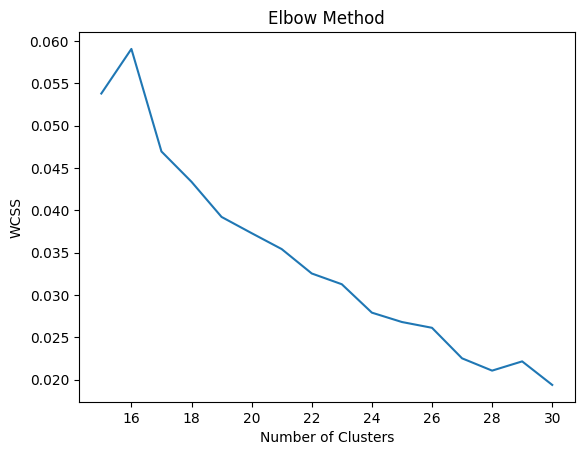

In [30]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

from tqdm import tqdm

coordinates_radians = np.radians(to_predict[['latitude_pop', 'longitude_pop']])
distance_matrix = haversine_distances(coordinates_radians)

wcss = []
for i in tqdm(range(15, 31)):
  kmeans = KMeans(n_clusters=i, init='k-means++', n_init='auto')
  kmeans.fit_predict(distance_matrix)
  wcss.append(kmeans.inertia_)
    
plt.plot(range(15, 31), wcss)
# plt.xticks(range(15, 31, 2), [str(x) for x in range(15, 31, 2)])
plt.title('Elbow Method')
plt.xlabel('Number of Clusters')
plt.ylabel('WCSS')
plt.show()

In [31]:
n_clusters = 17

kmeans = KMeans(n_clusters=n_clusters, init='k-means++', n_init='auto')
clusters = kmeans.fit_predict(distance_matrix)

print(clusters, np.unique(np.array(clusters)), sep='\n\n')

store_locations = kmeans.cluster_centers_

silhouette_avg = silhouette_score(to_predict[['latitude_pop', 'longitude_pop']], kmeans.labels_)
print('Silhouette Score:', silhouette_avg)

[7 8 8 ... 2 8 8]

[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16]
Silhouette Score: 0.5614431379777912


In [32]:
unique_clusters = set(clusters)

cluster_centers = []
for cluster in unique_clusters:
  center = coordinates_radians[clusters == cluster].mean(axis=0)
  center = tuple(np.degrees(center))
  cluster_centers.append(center)
        
map_cluster_centers_means_17 = {cluster: center for cluster, center in zip(np.unique(np.array(clusters)), cluster_centers)}

to_predict_means_17 = to_predict.copy(deep=True)
to_predict_means_17['cluster'] = clusters
to_predict_means_17['latitude_cluster_center'] = to_predict_means_17['cluster'].apply(lambda x: map_cluster_centers_means_17[x][0])
to_predict_means_17['longitude_cluster_center'] = to_predict_means_17['cluster'].apply(lambda x: map_cluster_centers_means_17[x][1])
to_predict_means_17

,latitude_pop,longitude_pop,metric_population,nearby_points,density,cluster,latitude_cluster_center,longitude_cluster_center
185,50.438700,30.419877,2.300694,403,12.228695,7,50.440894,30.415656
438,50.441142,30.548922,2.114725,369,12.075702,8,50.438354,30.549372
439,50.441784,30.548129,1.675935,377,12.090343,8,50.438354,30.549372
665,50.420434,30.489552,1.889514,285,11.816626,3,50.413562,30.478908
666,50.420235,30.488890,1.964939,292,11.828408,3,50.413562,30.478908
...,...,...,...,...,...,...,...,...
12696,50.441447,30.419575,2.655035,381,12.235063,7,50.440894,30.415656
12714,50.403104,30.377587,2.174703,226,11.716187,6,50.398193,30.381893
12733,50.388191,30.691875,2.338892,43,10.347625,2,50.396027,30.699520
12734,50.480408,30.535362,2.858052,11,9.020822,8,50.438354,30.549372


In [33]:
store_radius = 1500
population_radius = 1

colors = sns.husl_palette(n_colors=to_predict_means_17['cluster'].nunique())
colors = [rgb2hex(color) for color in colors]
color_dict = dict(zip(to_predict_means_17['cluster'].unique(), colors))

m = folium.Map(location=[to_predict_means_17['latitude_pop'].mean(), to_predict_means_17['longitude_pop'].mean()], zoom_start=12)
plotted_centers = []

for _, row in to_predict_means_17.iterrows():
  color = color_dict[row['cluster']]
  folium.Circle(location=[row['latitude_pop'], row['longitude_pop']],
                radius=population_radius,
                color=color,
                fill=True).add_to(m)

  center = row['cluster']
  if center not in plotted_centers:
    folium.Circle(location=map_cluster_centers_means_17[row['cluster']],
                  radius=store_radius,
                  color=color,
                  fill=True).add_to(m)

    plotted_centers.append(center)

m

In [34]:
n_clusters = 23

kmeans = KMeans(n_clusters=n_clusters, init='k-means++', n_init='auto')
clusters = kmeans.fit_predict(distance_matrix)

print(clusters, np.unique(np.array(clusters)), sep='\n\n')

store_locations = kmeans.cluster_centers_

silhouette_avg = silhouette_score(to_predict[['latitude_pop', 'longitude_pop']], kmeans.labels_)
print('Silhouette Score:', silhouette_avg)

[ 3  6  6 ... 18  6  6]

[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22]
Silhouette Score: 0.5199252218678304


In [35]:
unique_clusters = set(clusters)

cluster_centers = []
for cluster in unique_clusters:
  center = coordinates_radians[clusters == cluster].mean(axis=0)
  center = tuple(np.degrees(center))
  cluster_centers.append(center)
        
map_cluster_centers_means_23 = {cluster: center for cluster, center in zip(np.unique(np.array(clusters)), cluster_centers)}

to_predict_means_23 = to_predict.copy(deep=True)
to_predict_means_23['cluster'] = clusters
to_predict_means_23['latitude_cluster_center'] = to_predict_means_23['cluster'].apply(lambda x: map_cluster_centers_means_23[x][0])
to_predict_means_23['longitude_cluster_center'] = to_predict_means_23['cluster'].apply(lambda x: map_cluster_centers_means_23[x][1])
to_predict_means_23

,latitude_pop,longitude_pop,metric_population,nearby_points,density,cluster,latitude_cluster_center,longitude_cluster_center
185,50.438700,30.419877,2.300694,403,12.228695,3,50.443599,30.416933
438,50.441142,30.548922,2.114725,369,12.075702,6,50.438354,30.549372
439,50.441784,30.548129,1.675935,377,12.090343,6,50.438354,30.549372
665,50.420434,30.489552,1.889514,285,11.816626,13,50.418601,30.483171
666,50.420235,30.488890,1.964939,292,11.828408,13,50.418601,30.483171
...,...,...,...,...,...,...,...,...
12696,50.441447,30.419575,2.655035,381,12.235063,3,50.443599,30.416933
12714,50.403104,30.377587,2.174703,226,11.716187,20,50.400676,30.382493
12733,50.388191,30.691875,2.338892,43,10.347625,18,50.385186,30.698083
12734,50.480408,30.535362,2.858052,11,9.020822,6,50.438354,30.549372


In [36]:
store_radius = 1500
population_radius = 1

colors = sns.husl_palette(n_colors=to_predict_means_23['cluster'].nunique())
colors = [rgb2hex(color) for color in colors]
color_dict = dict(zip(to_predict_means_23['cluster'].unique(), colors))

m = folium.Map(location=[to_predict_means_23['latitude_pop'].mean(), to_predict_means_23['longitude_pop'].mean()], zoom_start=12)
plotted_centers = []

for _, row in to_predict_means_23.iterrows():
  color = color_dict[row['cluster']]
  folium.Circle(location=[row['latitude_pop'], row['longitude_pop']],
                radius=population_radius,
                color=color,
                fill=True).add_to(m)

  center = row['cluster']
  if center not in plotted_centers:
    folium.Circle(location=map_cluster_centers_means_23[row['cluster']],
                  radius=store_radius,
                  color=color,
                  fill=True).add_to(m)

    plotted_centers.append(center)

m

In [37]:
n_clusters = 27

kmeans = KMeans(n_clusters=n_clusters, init='k-means++', n_init='auto')
clusters = kmeans.fit_predict(distance_matrix)

print(clusters, np.unique(np.array(clusters)), sep='\n\n')

store_locations = kmeans.cluster_centers_

silhouette_avg = silhouette_score(to_predict[['latitude_pop', 'longitude_pop']], kmeans.labels_)
print('Silhouette Score:', silhouette_avg)

[17  0  0 ... 18 20 20]

[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26]
Silhouette Score: 0.5451111574945339


In [38]:
unique_clusters = set(clusters)

cluster_centers = []
for cluster in unique_clusters:
  center = coordinates_radians[clusters == cluster].mean(axis=0)
  center = tuple(np.degrees(center))
  cluster_centers.append(center)
        
map_cluster_centers_means_27 = {cluster: center for cluster, center in zip(np.unique(np.array(clusters)), cluster_centers)}

to_predict_means_27 = to_predict.copy(deep=True)
to_predict_means_27['cluster'] = clusters
to_predict_means_27['latitude_cluster_center'] = to_predict_means_27['cluster'].apply(lambda x: map_cluster_centers_means_27[x][0])
to_predict_means_27['longitude_cluster_center'] = to_predict_means_27['cluster'].apply(lambda x: map_cluster_centers_means_27[x][1])
to_predict_means_27

,latitude_pop,longitude_pop,metric_population,nearby_points,density,cluster,latitude_cluster_center,longitude_cluster_center
185,50.438700,30.419877,2.300694,403,12.228695,17,50.441689,30.416136
438,50.441142,30.548922,2.114725,369,12.075702,0,50.437399,30.549695
439,50.441784,30.548129,1.675935,377,12.090343,0,50.437399,30.549695
665,50.420434,30.489552,1.889514,285,11.816626,10,50.418601,30.483171
666,50.420235,30.488890,1.964939,292,11.828408,10,50.418601,30.483171
...,...,...,...,...,...,...,...,...
12696,50.441447,30.419575,2.655035,381,12.235063,17,50.441689,30.416136
12714,50.403104,30.377587,2.174703,226,11.716187,19,50.401604,30.373406
12733,50.388191,30.691875,2.338892,43,10.347625,18,50.385186,30.698083
12734,50.480408,30.535362,2.858052,11,9.020822,20,50.485877,30.489881


In [39]:
store_radius = 1500
population_radius = 1

colors = sns.husl_palette(n_colors=to_predict_means_27['cluster'].nunique())
colors = [rgb2hex(color) for color in colors]
color_dict = dict(zip(to_predict_means_27['cluster'].unique(), colors))

m = folium.Map(location=[to_predict_means_27['latitude_pop'].mean(), to_predict_means_27['longitude_pop'].mean()], zoom_start=12)
plotted_centers = []

for _, row in to_predict_means_27.iterrows():
  color = color_dict[row['cluster']]
  folium.Circle(location=[row['latitude_pop'], row['longitude_pop']],
                radius=population_radius,
                color=color,
                fill=True).add_to(m)

  center = row['cluster']
  if center not in plotted_centers:
    folium.Circle(location=map_cluster_centers_means_27[row['cluster']],
                  radius=store_radius,
                  color=color,
                  fill=True).add_to(m)

    plotted_centers.append(center)

m

In [40]:
!pip install haversine
from haversine import haversine


def haversine_distance(row):
  lat1, lon1 = row['latitude_pop'], row['longitude_pop']
  lat2, lon2 = row['latitude_cluster_center'], row['longitude_cluster_center']
  return haversine((lat1, lon1), (lat2, lon2), unit='m')

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [41]:
to_predict_dbscan_updated

,latitude_pop,longitude_pop,metric_population,nearby_points,density,cluster,latitude_cluster_center,longitude_cluster_center
0,50.438700,30.419877,2.300694,403.0,12.228695,0,50.433964,30.420562
1,50.441142,30.548922,2.114725,369.0,12.075702,1,50.439438,30.548042
2,50.441784,30.548129,1.675935,377.0,12.090343,1,50.439438,30.548042
3,50.420434,30.489552,1.889514,285.0,11.816626,2,50.418926,30.482575
4,50.420235,30.488890,1.964939,292.0,11.828408,2,50.418926,30.482575
...,...,...,...,...,...,...,...,...
1887,50.441447,30.419575,2.655035,381.0,12.235063,0,50.433964,30.420562
1888,50.403104,30.377587,2.174703,226.0,11.716187,13,50.397747,30.382939
1889,50.388191,30.691875,2.338892,43.0,10.347625,12,50.385476,30.697706
1890,50.480408,30.535362,2.858052,11.0,9.020822,1,50.441142,30.548922


In [42]:
to_predict_dbscan_updated['distance'] = to_predict_dbscan_updated.apply(haversine_distance, axis=1)


dbscan_grouped = to_predict_dbscan_updated.groupby('cluster').agg({'metric_population': 'mean',
                                                                  'nearby_points': 'mean',
                                                                  'density': 'mean',
                                                                  'distance': 'mean'}).reset_index()
dbscan_grouped['latitude_cluster_center'] = dbscan_grouped['cluster'].apply(lambda x: map_cluster_centers_dbscan[x][0])
dbscan_grouped['longitude_cluster_center'] = dbscan_grouped['cluster'].apply(lambda x: map_cluster_centers_dbscan[x][1])
dbscan_grouped['count'] = to_predict_dbscan_updated.groupby('cluster').size().reset_index(drop=True)
dbscan_grouped = dbscan_grouped[['cluster', 'count', 'nearby_points', 'density', 'metric_population', 'distance', 'latitude_cluster_center', 'longitude_cluster_center']]

dbscan_grouped = dbscan_grouped.sort_values(by=['count', 'nearby_points', 'density', 'metric_population', 'distance'], ascending=False).reset_index(drop=True)
dbscan_grouped

,cluster,count,nearby_points,density,metric_population,distance,latitude_cluster_center,longitude_cluster_center
0,3,345,226.408696,11.707458,2.119445,1195.753844,50.393497,30.498946
1,0,315,316.863492,11.990564,2.033338,926.496942,50.433964,30.420562
2,13,205,199.068293,11.652592,1.801839,658.666581,50.397747,30.382939
3,9,153,292.496732,11.860550,2.044479,1055.695312,50.471487,30.434800
4,10,116,100.439655,11.072521,1.890114,973.200575,50.354256,30.473583
5,1,89,366.438202,11.968072,2.071656,654.047420,50.439438,30.548042
6,2,87,280.609195,11.690667,2.160701,736.270798,50.418926,30.482575
7,6,83,86.168675,11.035420,1.926855,484.220159,50.448731,30.673295
8,7,67,47.567164,10.257198,2.138264,1111.051921,50.371639,30.547113
9,5,61,96.049180,10.616641,2.228344,833.693974,50.422458,30.686019


In [43]:
store_radius = 1500
population_radius = 1

n_colors = dbscan_grouped['cluster'].nunique()
palette = sns.color_palette('Reds', n_colors)
colors = [palette[int(i/n_colors*len(palette))] for i in range(n_colors)][::-1]
colors = [rgb2hex(color) for color in colors]
color_dict = dict(zip(dbscan_grouped['cluster'].unique(), colors))

m = folium.Map(location=[dbscan_grouped['latitude_cluster_center'].mean(), dbscan_grouped['longitude_cluster_center'].mean()], zoom_start=12)

for i, row in dbscan_grouped.iterrows():
  color = color_dict[int(row['cluster'])]
  folium.Circle(location=[row['latitude_cluster_center'], row['longitude_cluster_center']],
                radius=store_radius,
                color=color,
                fill=True,
                tooltip=folium.map.Tooltip(text=f'top: {i + 1}; cluster: {int(row["cluster"])}', style='font-size: 15pt;')).add_to(m)

  for j, row1 in to_predict_dbscan_updated[to_predict_dbscan_updated['cluster'] == row['cluster']].iterrows():
    folium.Circle(location=[row1['latitude_pop'], row1['longitude_pop']],
                  radius=population_radius,
                  color=color,
                  fill=True).add_to(m)

m

In [44]:
to_predict_hier

,latitude_pop,longitude_pop,metric_population,nearby_points,density,cluster,latitude_cluster_center,longitude_cluster_center
185,50.438700,30.419877,2.300694,403,12.228695,16,50.440917,30.415622
438,50.441142,30.548922,2.114725,369,12.075702,12,50.437399,30.549695
439,50.441784,30.548129,1.675935,377,12.090343,12,50.437399,30.549695
665,50.420434,30.489552,1.889514,285,11.816626,9,50.418918,30.482474
666,50.420235,30.488890,1.964939,292,11.828408,9,50.418918,30.482474
...,...,...,...,...,...,...,...,...
12696,50.441447,30.419575,2.655035,381,12.235063,16,50.440917,30.415622
12714,50.403104,30.377587,2.174703,226,11.716187,15,50.398193,30.381893
12733,50.388191,30.691875,2.338892,43,10.347625,3,50.384493,30.697676
12734,50.480408,30.535362,2.858052,11,9.020822,21,50.489984,30.494067


In [45]:
to_predict_hier['distance'] = to_predict_hier.apply(haversine_distance, axis=1)


hier_grouped = to_predict_hier.groupby('cluster').agg({'metric_population': 'mean',
                                                       'nearby_points': 'mean',
                                                       'density': 'mean',
                                                       'distance': 'mean'}).reset_index()
hier_grouped['latitude_cluster_center'] = hier_grouped['cluster'].apply(lambda x: map_cluster_centers_hier[x][0])
hier_grouped['longitude_cluster_center'] = hier_grouped['cluster'].apply(lambda x: map_cluster_centers_hier[x][1])
hier_grouped['count'] = to_predict_hier.groupby('cluster').size().reset_index(drop=True)
hier_grouped = hier_grouped[['cluster', 'count', 'nearby_points', 'density', 'metric_population', 'distance', 'latitude_cluster_center', 'longitude_cluster_center']]

hier_grouped = hier_grouped.sort_values(by=['count', 'nearby_points', 'density', 'metric_population', 'distance'], ascending=False).reset_index(drop=True)
hier_grouped

,cluster,count,nearby_points,density,metric_population,distance,latitude_cluster_center,longitude_cluster_center
0,15,205,199.068293,11.652592,1.801839,646.757832,50.398193,30.381893
1,17,172,311.988372,11.947480,2.010016,573.047411,50.427554,30.424912
2,11,158,259.955696,11.907440,2.064153,548.133102,50.388651,30.488917
3,16,140,321.364286,12.044682,2.065104,442.063740,50.440917,30.415622
4,10,121,221.578512,11.696270,2.178114,623.600471,50.398415,30.507714
5,2,94,98.659574,11.084014,1.988430,950.176593,50.444875,30.670603
6,5,88,59.147727,10.608547,1.618939,881.666646,50.349229,30.433346
7,12,87,374.540230,12.034621,2.053143,595.107727,50.437399,30.549695
8,18,86,290.000000,11.995246,1.974462,429.543834,50.477450,30.439780
9,9,79,297.911392,11.819335,2.246587,566.064417,50.418918,30.482474


In [46]:
store_radius = 1500
population_radius = 1

n_colors = hier_grouped['cluster'].nunique()
palette = sns.color_palette('Reds', n_colors)
colors = [palette[int(i/n_colors*len(palette))] for i in range(n_colors)][::-1]
colors = [rgb2hex(color) for color in colors]
color_dict = dict(zip(hier_grouped['cluster'].unique(), colors))

m = folium.Map(location=[hier_grouped['latitude_cluster_center'].mean(), hier_grouped['longitude_cluster_center'].mean()], zoom_start=12)

for i, row in hier_grouped.iterrows():
  color = color_dict[int(row['cluster'])]
  folium.Circle(location=[row['latitude_cluster_center'], row['longitude_cluster_center']],
                radius=store_radius,
                color=color,
                fill=True,
                tooltip=folium.map.Tooltip(text=f'top: {i + 1}; cluster: {int(row["cluster"])}', style='font-size: 15pt;')).add_to(m)

  for j, row1 in to_predict_hier[to_predict_hier['cluster'] == row['cluster']].iterrows():
    folium.Circle(location=[row1['latitude_pop'], row1['longitude_pop']],
                  radius=population_radius,
                  color=color,
                  fill=True).add_to(m)

m

In [47]:
to_predict_means_17

,latitude_pop,longitude_pop,metric_population,nearby_points,density,cluster,latitude_cluster_center,longitude_cluster_center
185,50.438700,30.419877,2.300694,403,12.228695,7,50.440894,30.415656
438,50.441142,30.548922,2.114725,369,12.075702,8,50.438354,30.549372
439,50.441784,30.548129,1.675935,377,12.090343,8,50.438354,30.549372
665,50.420434,30.489552,1.889514,285,11.816626,3,50.413562,30.478908
666,50.420235,30.488890,1.964939,292,11.828408,3,50.413562,30.478908
...,...,...,...,...,...,...,...,...
12696,50.441447,30.419575,2.655035,381,12.235063,7,50.440894,30.415656
12714,50.403104,30.377587,2.174703,226,11.716187,6,50.398193,30.381893
12733,50.388191,30.691875,2.338892,43,10.347625,2,50.396027,30.699520
12734,50.480408,30.535362,2.858052,11,9.020822,8,50.438354,30.549372


In [48]:
to_predict_means_17['distance'] = to_predict_means_17.apply(haversine_distance, axis=1)


means_17_grouped = to_predict_means_17.groupby('cluster').agg({'metric_population': 'mean',
                                                       'nearby_points': 'mean',
                                                       'density': 'mean',
                                                       'distance': 'mean'}).reset_index()
means_17_grouped['latitude_cluster_center'] = means_17_grouped['cluster'].apply(lambda x: map_cluster_centers_means_17[x][0])
means_17_grouped['longitude_cluster_center'] = means_17_grouped['cluster'].apply(lambda x: map_cluster_centers_means_17[x][1])
means_17_grouped['count'] = to_predict_means_17.groupby('cluster').size().reset_index(drop=True)
means_17_grouped = means_17_grouped[['cluster', 'count', 'nearby_points', 'density', 'metric_population', 'distance', 'latitude_cluster_center', 'longitude_cluster_center']]

means_17_grouped = means_17_grouped.sort_values(by=['count', 'nearby_points', 'density', 'metric_population', 'distance'], ascending=False).reset_index(drop=True)
means_17_grouped

,cluster,count,nearby_points,density,metric_population,distance,latitude_cluster_center,longitude_cluster_center
0,6,205,199.068293,11.652592,1.801839,646.757832,50.398193,30.381893
1,15,187,255.909091,11.897564,2.077279,616.024981,50.389477,30.490408
2,13,170,311.547059,11.946753,2.006366,568.641701,50.427479,30.425027
3,14,151,87.741722,10.895907,1.993089,1739.001509,50.446829,30.673012
4,7,143,321.804196,12.041740,2.069816,452.548725,50.440894,30.415656
5,12,134,198.500000,11.526042,2.213998,833.277956,50.398165,30.516582
6,10,118,99.567797,11.061660,1.881161,974.051582,50.353866,30.473320
7,3,110,253.363636,11.597605,2.109480,1159.467327,50.413562,30.478908
8,16,100,263.400000,11.834563,1.991498,955.621385,50.478917,30.445759
9,8,89,366.438202,11.968072,2.071656,658.721075,50.438354,30.549372


In [49]:
store_radius = 1500
population_radius = 1

n_colors = means_17_grouped['cluster'].nunique()
palette = sns.color_palette('Reds', n_colors)
colors = [palette[int(i/n_colors*len(palette))] for i in range(n_colors)][::-1]
colors = [rgb2hex(color) for color in colors]
color_dict = dict(zip(means_17_grouped['cluster'].unique(), colors))

m = folium.Map(location=[means_17_grouped['latitude_cluster_center'].mean(), means_17_grouped['longitude_cluster_center'].mean()], zoom_start=12)

for i, row in means_17_grouped.iterrows():
  color = color_dict[int(row['cluster'])]
  folium.Circle(location=[row['latitude_cluster_center'], row['longitude_cluster_center']],
                radius=store_radius,
                color=color,
                fill=True,
                tooltip=folium.map.Tooltip(text=f'top: {i + 1}; cluster: {int(row["cluster"])}', style='font-size: 15pt;')).add_to(m)

  for j, row1 in to_predict_means_17[to_predict_means_17['cluster'] == row['cluster']].iterrows():
    folium.Circle(location=[row1['latitude_pop'], row1['longitude_pop']],
                  radius=population_radius,
                  color=color,
                  fill=True).add_to(m)

m

In [50]:
to_predict_means_23

,latitude_pop,longitude_pop,metric_population,nearby_points,density,cluster,latitude_cluster_center,longitude_cluster_center
185,50.438700,30.419877,2.300694,403,12.228695,3,50.443599,30.416933
438,50.441142,30.548922,2.114725,369,12.075702,6,50.438354,30.549372
439,50.441784,30.548129,1.675935,377,12.090343,6,50.438354,30.549372
665,50.420434,30.489552,1.889514,285,11.816626,13,50.418601,30.483171
666,50.420235,30.488890,1.964939,292,11.828408,13,50.418601,30.483171
...,...,...,...,...,...,...,...,...
12696,50.441447,30.419575,2.655035,381,12.235063,3,50.443599,30.416933
12714,50.403104,30.377587,2.174703,226,11.716187,20,50.400676,30.382493
12733,50.388191,30.691875,2.338892,43,10.347625,18,50.385186,30.698083
12734,50.480408,30.535362,2.858052,11,9.020822,6,50.438354,30.549372


In [51]:
to_predict_means_23['distance'] = to_predict_means_23.apply(haversine_distance, axis=1)


means_23_grouped = to_predict_means_23.groupby('cluster').agg({'metric_population': 'mean',
                                                       'nearby_points': 'mean',
                                                       'density': 'mean',
                                                       'distance': 'mean'}).reset_index()
means_23_grouped['latitude_cluster_center'] = means_23_grouped['cluster'].apply(lambda x: map_cluster_centers_means_23[x][0])
means_23_grouped['longitude_cluster_center'] = means_23_grouped['cluster'].apply(lambda x: map_cluster_centers_means_23[x][1])
means_23_grouped['count'] = to_predict_means_23.groupby('cluster').size().reset_index(drop=True)
means_23_grouped = means_23_grouped[['cluster', 'count', 'nearby_points', 'density', 'metric_population', 'distance', 'latitude_cluster_center', 'longitude_cluster_center']]

means_23_grouped = means_23_grouped.sort_values(by=['count', 'nearby_points', 'density', 'metric_population', 'distance'], ascending=False).reset_index(drop=True)
means_23_grouped

,cluster,count,nearby_points,density,metric_population,distance,latitude_cluster_center,longitude_cluster_center
0,11,173,313.184971,11.950624,2.009124,573.770673,50.427614,30.424953
1,3,166,319.524096,11.994346,2.062323,690.851856,50.443599,30.416933
2,14,157,260.127389,11.907264,2.061762,546.443418,50.388622,30.488854
3,10,130,288.784615,11.878945,2.041557,984.794487,50.475855,30.442458
4,20,127,211.929134,11.784958,1.796089,515.983008,50.400676,30.382493
5,15,122,83.598361,10.894532,1.929594,1444.709238,50.453231,30.671017
6,0,109,225.926606,11.749200,2.198944,542.594389,50.397869,30.506937
7,6,89,366.438202,11.968072,2.071656,658.721075,50.438354,30.549372
8,12,88,59.147727,10.608547,1.618939,881.666646,50.349229,30.433346
9,13,83,289.506024,11.770599,2.191712,604.548183,50.418601,30.483171


In [52]:
store_radius = 1500
population_radius = 1

n_colors = means_23_grouped['cluster'].nunique()
palette = sns.color_palette('Reds', n_colors)
colors = [palette[int(i/n_colors*len(palette))] for i in range(n_colors)][::-1]
colors = [rgb2hex(color) for color in colors]
color_dict = dict(zip(means_23_grouped['cluster'].unique(), colors))

m = folium.Map(location=[means_23_grouped['latitude_cluster_center'].mean(), means_23_grouped['longitude_cluster_center'].mean()], zoom_start=12)

for i, row in means_23_grouped.iterrows():
  color = color_dict[int(row['cluster'])]
  folium.Circle(location=[row['latitude_cluster_center'], row['longitude_cluster_center']],
                radius=store_radius,
                color=color,
                fill=True,
                tooltip=folium.map.Tooltip(text=f'top: {i + 1}; cluster: {int(row["cluster"])}', style='font-size: 15pt;')).add_to(m)

  for j, row1 in to_predict_means_23[to_predict_means_23['cluster'] == row['cluster']].iterrows():
    folium.Circle(location=[row1['latitude_pop'], row1['longitude_pop']],
                  radius=population_radius,
                  color=color,
                  fill=True).add_to(m)

m

In [53]:
to_predict_means_27

,latitude_pop,longitude_pop,metric_population,nearby_points,density,cluster,latitude_cluster_center,longitude_cluster_center
185,50.438700,30.419877,2.300694,403,12.228695,17,50.441689,30.416136
438,50.441142,30.548922,2.114725,369,12.075702,0,50.437399,30.549695
439,50.441784,30.548129,1.675935,377,12.090343,0,50.437399,30.549695
665,50.420434,30.489552,1.889514,285,11.816626,10,50.418601,30.483171
666,50.420235,30.488890,1.964939,292,11.828408,10,50.418601,30.483171
...,...,...,...,...,...,...,...,...
12696,50.441447,30.419575,2.655035,381,12.235063,17,50.441689,30.416136
12714,50.403104,30.377587,2.174703,226,11.716187,19,50.401604,30.373406
12733,50.388191,30.691875,2.338892,43,10.347625,18,50.385186,30.698083
12734,50.480408,30.535362,2.858052,11,9.020822,20,50.485877,30.489881


In [54]:
to_predict_means_27['distance'] = to_predict_means_27.apply(haversine_distance, axis=1)


means_27_grouped = to_predict_means_27.groupby('cluster').agg({'metric_population': 'mean',
                                                       'nearby_points': 'mean',
                                                       'density': 'mean',
                                                       'distance': 'mean'}).reset_index()
means_27_grouped['latitude_cluster_center'] = means_27_grouped['cluster'].apply(lambda x: map_cluster_centers_means_27[x][0])
means_27_grouped['longitude_cluster_center'] = means_27_grouped['cluster'].apply(lambda x: map_cluster_centers_means_27[x][1])
means_27_grouped['count'] = to_predict_means_27.groupby('cluster').size().reset_index(drop=True)
means_27_grouped = means_27_grouped[['cluster', 'count', 'nearby_points', 'density', 'metric_population', 'distance', 'latitude_cluster_center', 'longitude_cluster_center']]

means_27_grouped = means_27_grouped.sort_values(by=['count', 'nearby_points', 'density', 'metric_population', 'distance'], ascending=False).reset_index(drop=True)
means_27_grouped

,cluster,count,nearby_points,density,metric_population,distance,latitude_cluster_center,longitude_cluster_center
0,4,171,312.134503,11.948067,2.007806,570.110811,50.427522,30.425007
1,17,151,322.218543,12.021449,2.067777,513.841722,50.441689,30.416136
2,5,136,210.205882,11.792242,1.801653,484.947067,50.396463,30.386199
3,8,133,309.466165,11.965796,2.032680,826.354825,50.472633,30.435844
4,9,119,237.957983,11.867280,2.057870,419.089687,50.393344,30.499345
5,3,98,268.887755,11.879173,2.117068,444.700698,50.386797,30.485122
6,16,88,91.943182,11.056962,1.951601,699.504359,50.446249,30.673243
7,15,88,59.147727,10.608547,1.618939,881.666646,50.349229,30.433346
8,0,87,374.540230,12.034621,2.053143,595.107727,50.437399,30.549695
9,10,83,289.506024,11.770599,2.191712,604.548183,50.418601,30.483171


In [55]:
store_radius = 1500
population_radius = 1

n_colors = means_27_grouped['cluster'].nunique()
palette = sns.color_palette('Reds', n_colors)
colors = [palette[int(i/n_colors*len(palette))] for i in range(n_colors)][::-1]
colors = [rgb2hex(color) for color in colors]
color_dict = dict(zip(means_27_grouped['cluster'].unique(), colors))

m = folium.Map(location=[means_27_grouped['latitude_cluster_center'].mean(), means_27_grouped['longitude_cluster_center'].mean()], zoom_start=12)

for i, row in means_27_grouped.iterrows():
  color = color_dict[int(row['cluster'])]
  folium.Circle(location=[row['latitude_cluster_center'], row['longitude_cluster_center']],
                radius=store_radius,
                color=color,
                fill=True,
                tooltip=folium.map.Tooltip(text=f'top: {i + 1}; cluster: {int(row["cluster"])}', style='font-size: 15pt;')).add_to(m)

  for j, row1 in to_predict_means_27[to_predict_means_27['cluster'] == row['cluster']].iterrows():
    folium.Circle(location=[row1['latitude_pop'], row1['longitude_pop']],
                  radius=population_radius,
                  color=color,
                  fill=True).add_to(m)

m

In [56]:
districts_info = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/Others/Fozzy/districts_info.txt')
population_districts = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/Others/Fozzy/population_districts.txt')

In [57]:
latitude = districts_info.pop('latitude')
longitude = districts_info.pop('longitude')
districts_info.insert(1, 'latitude', latitude)
districts_info.insert(2, 'longitude', longitude)

districts_info

,district,latitude,longitude,square,population,population_density,the_left_bank_of_the_dnieper,the_right_bank_of_the_dnieper,avg_monthly_salary_full_time_employee,volume_of_sold_products,...,retail,soccer_field,sporting_goods_retail,sports_and_recreation,stadium,tattoo_parlor,toy__game_store,vegan_and_vegetarian_restaurant,wine_store,women's_store
0,Holosiivskyi,50.314050,30.567880,156,247600.0,1584,0,1,17994,4.921296e+11,...,0.0,0.555556,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,Darnytskyi,50.417969,30.595241,134,314700.0,2480,1,0,10831,1.109734e+11,...,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,Desnianskyi,50.445792,30.438757,148,358300.0,2421,1,0,10915,5.089720e+10,...,0.0,0.000000,0.0,0.0,0.1,0.1,0.0,0.0,0.0,0.1
3,Dniprovskyi,50.466930,30.629400,67,354700.0,5294,1,0,11948,1.620957e+11,...,0.0,0.000000,0.0,0.2,0.0,0.0,0.0,0.0,0.0,0.0
4,Obolonskyi,50.491465,30.497470,110,315500.0,2868,0,1,12973,1.620957e+11,...,0.0,0.000000,0.1,0.0,0.0,0.0,0.1,0.1,0.0,0.0
5,Pecherskyi,50.436346,30.537156,27,152000.0,5630,0,1,18678,8.486631e+11,...,0.0,0.000000,0.0,0.0,0.0,0.1,0.0,0.0,0.1,0.0
6,Podilskyi,50.477792,30.477064,34,198100.0,5826,0,1,19463,8.486631e+11,...,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7,Sviatoshynskyi,50.448768,30.386366,110,340700.0,3097,0,1,11666,1.261109e+11,...,0.1,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8,Solomianskyi,50.431873,30.470281,40,364800.0,9120,0,1,14256,2.139548e+11,...,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
9,Shevchenkivskyi,50.464870,30.444800,27,230200.0,9208,0,1,16849,1.102394e+12,...,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [58]:
stores_districts = stores.copy(deep=True)
stores_districts

,store,latitude,longitude,metric_store
0,Store 1,50.415258,30.522344,2.182985
1,Store 2,50.495292,30.512299,2.636889
2,Store 3,50.414301,30.650869,2.503791
3,Store 4,50.471703,30.478740,2.376577
4,Store 5,50.532248,30.608288,2.340841
...,...,...,...,...
89,Store 90,50.472699,30.406233,2.236537
90,Store 91,50.411725,30.412683,2.419625
91,Store 92,50.471310,30.517505,2.485153
92,Store 93,50.431483,30.617812,2.438800


In [59]:
from geopy.geocoders import Nominatim
from tqdm import tqdm


def get_district(row):
  location = (row.latitude, row.longitude)
  address = geolocator.reverse(location)
  try:
    district = address.raw['address']['borough'].split()[0]
  except:
    district = None

  return district


geolocator = Nominatim(user_agent="myGeocoder")
tqdm.pandas()
stores_districts['district'] = stores_districts.progress_apply(get_district, axis=1)
stores_districts

100%|██████████| 94/94 [00:47<00:00,  1.99it/s]


,store,latitude,longitude,metric_store,district
0,Store 1,50.415258,30.522344,2.182985,Голосіївський
1,Store 2,50.495292,30.512299,2.636889,Оболонський
2,Store 3,50.414301,30.650869,2.503791,Дарницький
3,Store 4,50.471703,30.478740,2.376577,Шевченківський
4,Store 5,50.532248,30.608288,2.340841,Деснянський
...,...,...,...,...,...
89,Store 90,50.472699,30.406233,2.236537,Шевченківський
90,Store 91,50.411725,30.412683,2.419625,Святошинський
91,Store 92,50.471310,30.517505,2.485153,Подільський
92,Store 93,50.431483,30.617812,2.438800,Дніпровський


In [60]:
en_districts = {'Голосіївський': 'Holosiivskyi',
                'Оболонський': 'Obolonskyi',
                'Печерський': 'Pecherskyi',
                'Подільський': 'Podilskyi',
                'Святошинський': 'Sviatoshynskyi',
                'Солом\'янський': 'Solomianskyi',
                'Шевченківський': 'Shevchenkivskyi',
                'Дарницький': 'Darnytskyi',
                'Деснянський': 'Desnianskyi',
                'Дніпровський': 'Dniprovskyi'}

In [61]:
stores_districts['district'].replace({'Солом’янський': 'Солом\'янський'}, inplace=True)
stores_districts['district'].replace(en_districts, inplace=True)
stores_districts

,store,latitude,longitude,metric_store,district
0,Store 1,50.415258,30.522344,2.182985,Holosiivskyi
1,Store 2,50.495292,30.512299,2.636889,Obolonskyi
2,Store 3,50.414301,30.650869,2.503791,Darnytskyi
3,Store 4,50.471703,30.478740,2.376577,Shevchenkivskyi
4,Store 5,50.532248,30.608288,2.340841,Desnianskyi
...,...,...,...,...,...
89,Store 90,50.472699,30.406233,2.236537,Shevchenkivskyi
90,Store 91,50.411725,30.412683,2.419625,Sviatoshynskyi
91,Store 92,50.471310,30.517505,2.485153,Podilskyi
92,Store 93,50.431483,30.617812,2.438800,Dniprovskyi


In [62]:
population_districts['district'].replace({'Солом’янський': 'Солом\'янський'}, inplace=True)
population_districts['district'].replace(en_districts, inplace=True)
population_districts

,latitude,longitude,metric_population,district
0,50.435976,30.625646,1.957358,Dniprovskyi
1,50.435185,30.626106,1.948965,Dniprovskyi
2,50.436381,30.626037,1.698104,Dniprovskyi
3,50.436153,30.626818,2.087091,Dniprovskyi
4,50.435430,30.626640,2.133889,Dniprovskyi
...,...,...,...,...
12747,50.475089,30.447804,1.971530,Shevchenkivskyi
12748,50.462290,30.487367,2.366262,Shevchenkivskyi
12749,50.462651,30.487229,2.563051,Shevchenkivskyi
12750,50.462345,30.488185,2.515801,Shevchenkivskyi


In [63]:
stores_districts.isnull().sum()

store           0
latitude        0
longitude       0
metric_store    0
district        0
dtype: int64

In [64]:
stores_districts.value_counts('district').reset_index(name='stores_number')

,district,stores_number
0,Obolonskyi,17
1,Darnytskyi,13
2,Dniprovskyi,12
3,Desnianskyi,11
4,Shevchenkivskyi,9
5,Podilskyi,8
6,Sviatoshynskyi,8
7,Holosiivskyi,6
8,Pecherskyi,5
9,Solomianskyi,5


In [65]:
districts_info = districts_info.merge(stores_districts.value_counts('district').reset_index(name='stores_number'), on='district')
districts_info = districts_info.merge(population_districts.groupby('district').agg({'metric_population': 'mean', 'longitude': 'count'}).reset_index().rename(columns={'longitude': 'population_number'}), on='district')
districts_info

,district,latitude,longitude,square,population,population_density,the_left_bank_of_the_dnieper,the_right_bank_of_the_dnieper,avg_monthly_salary_full_time_employee,volume_of_sold_products,...,sports_and_recreation,stadium,tattoo_parlor,toy__game_store,vegan_and_vegetarian_restaurant,wine_store,women's_store,stores_number,metric_population,population_number
0,Holosiivskyi,50.314050,30.567880,156,247600.0,1584,0,1,17994,4.921296e+11,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,6,2.098839,1334
1,Darnytskyi,50.417969,30.595241,134,314700.0,2480,1,0,10831,1.109734e+11,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,13,2.387740,1106
2,Desnianskyi,50.445792,30.438757,148,358300.0,2421,1,0,10915,5.089720e+10,...,0.0,0.1,0.1,0.0,0.0,0.0,0.1,11,2.425979,789
3,Dniprovskyi,50.466930,30.629400,67,354700.0,5294,1,0,11948,1.620957e+11,...,0.2,0.0,0.0,0.0,0.0,0.0,0.0,12,2.174103,1626
4,Obolonskyi,50.491465,30.497470,110,315500.0,2868,0,1,12973,1.620957e+11,...,0.0,0.0,0.0,0.1,0.1,0.0,0.0,17,2.321764,900
5,Pecherskyi,50.436346,30.537156,27,152000.0,5630,0,1,18678,8.486631e+11,...,0.0,0.0,0.1,0.0,0.0,0.1,0.0,5,2.078283,1059
6,Podilskyi,50.477792,30.477064,34,198100.0,5826,0,1,19463,8.486631e+11,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,8,2.109686,870
7,Sviatoshynskyi,50.448768,30.386366,110,340700.0,3097,0,1,11666,1.261109e+11,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,8,2.266435,993
8,Solomianskyi,50.431873,30.470281,40,364800.0,9120,0,1,14256,2.139548e+11,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,5,2.083463,1670
9,Shevchenkivskyi,50.464870,30.444800,27,230200.0,9208,0,1,16849,1.102394e+12,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,9,1.981551,1972


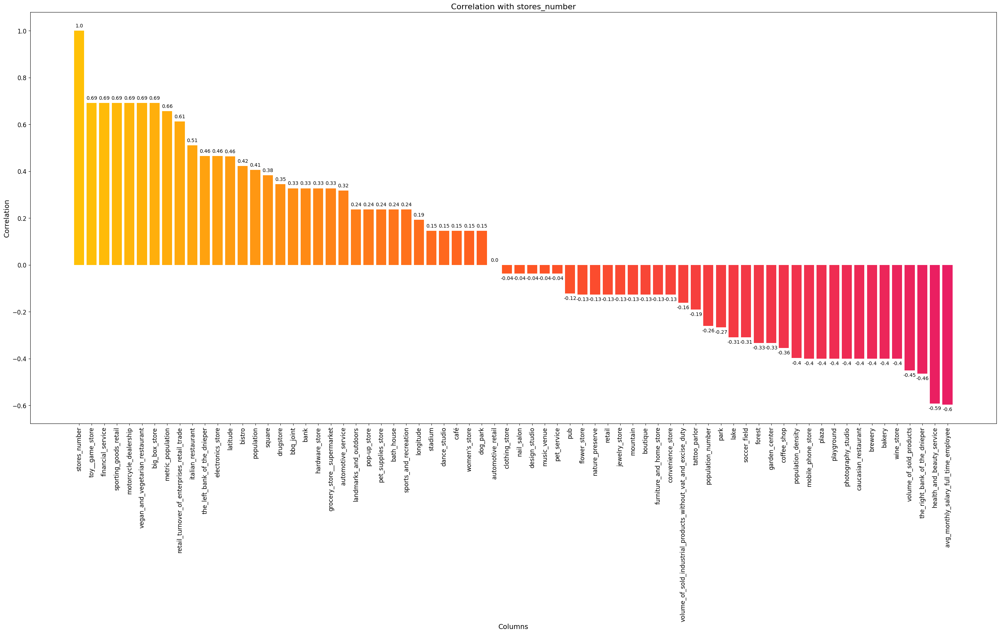

In [66]:
import matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap


col_name = 'stores_number'
corr = districts_info.corr()[[col_name]].sort_values(col_name, ascending=False)
cmap = LinearSegmentedColormap.from_list('mycmap', ['#FFC107', '#FF5722', '#E91E63'])


fig, ax = plt.subplots(figsize=(35, 15))
ax.bar(corr.index, corr[col_name], color=cmap(np.linspace(0, 1, len(corr.index))))
ax.tick_params(axis='x', labelrotation=90, labelsize=12)
ax.tick_params(axis='y', labelsize=12)
ax.set_xlabel('Columns', fontsize=14)
ax.set_ylabel('Correlation', fontsize=14)
ax.set_title(f'Correlation with {col_name}', fontsize=16)

for i, val in enumerate(corr[col_name]):
    if val < 0:
        ax.text(i, val - 0.01, round(val, 2), ha='center', va='top', fontsize=10)
    else:
        ax.text(i, val + 0.01, round(val, 2), ha='center', va='bottom', fontsize=10)

plt.show()

In [67]:
import pandas as pd
from sklearn.ensemble import RandomForestRegressor

X = districts_info.drop(['district', 'stores_number'], axis=1)
y = districts_info['stores_number']

rfc = RandomForestRegressor()
rfc.fit(X, y)

importances = rfc.feature_importances_
feature_names = X.columns

df_importances = pd.DataFrame({'feature': feature_names, 'importance': importances})
df_importances.sort_values('importance', ascending=False).head(15)

,feature,importance
9,retail_turnover_of_enterprises_retail_trade,0.201468
67,metric_population,0.115275
0,latitude,0.087989
5,the_left_bank_of_the_dnieper,0.081547
6,the_right_bank_of_the_dnieper,0.067376
7,avg_monthly_salary_full_time_employee,0.056146
8,volume_of_sold_products,0.042194
1,longitude,0.040725
4,population_density,0.032078
38,health_and_beauty_service,0.028570


In [68]:
economic_features = ['avg_monthly_salary_full_time_employee', 'volume_of_sold_products', 'retail_turnover_of_enterprises_retail_trade', 'volume_of_sold_industrial_products_without_vat_and_excise_duty']
population_features = ['population', 'population_density', 'metric_population', 'population_number']
attractive_places_features = ['bbq_joint', 'bakery', 'big_box_store', 'bistro', 'brewery', 'caucasian_restaurant', 'electronics_store',
                              'financial_service', 'health_and_beauty_service', 'italian_restaurant', 'mobile_phone_store', 'motorcycle_dealership',
                              'photography_studio', 'playground', 'plaza', 'sporting_goods_retail', 'toy__game_store', 'vegan_and_vegetarian_restaurant', 'wine_store']

districts_top = districts_info[['district'] + economic_features + population_features + attractive_places_features]
districts_top

,district,avg_monthly_salary_full_time_employee,volume_of_sold_products,retail_turnover_of_enterprises_retail_trade,volume_of_sold_industrial_products_without_vat_and_excise_duty,population,population_density,metric_population,population_number,bbq_joint,...,italian_restaurant,mobile_phone_store,motorcycle_dealership,photography_studio,playground,plaza,sporting_goods_retail,toy__game_store,vegan_and_vegetarian_restaurant,wine_store
0,Holosiivskyi,17994,4.921296e+11,1.070972e+10,1.649513e+10,247600.0,1584,2.098839,1334,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,Darnytskyi,10831,1.109734e+11,1.351148e+10,5.001107e+09,314700.0,2480,2.387740,1106,0.1,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,Desnianskyi,10915,5.089720e+10,7.755993e+09,8.425086e+08,358300.0,2421,2.425979,789,0.0,...,0.1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,Dniprovskyi,11948,1.620957e+11,8.009693e+09,5.155946e+09,354700.0,5294,2.174103,1626,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,Obolonskyi,12973,1.620957e+11,1.393646e+10,7.247357e+09,315500.0,2868,2.321764,900,0.0,...,0.2,0.0,0.1,0.0,0.0,0.0,0.1,0.1,0.1,0.0
5,Pecherskyi,18678,8.486631e+11,6.421300e+09,2.057045e+10,152000.0,5630,2.078283,1059,0.0,...,0.1,0.1,0.0,0.1,0.0,0.0,0.0,0.0,0.0,0.1
6,Podilskyi,19463,8.486631e+11,4.115164e+09,8.162403e+09,198100.0,5826,2.109686,870,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7,Sviatoshynskyi,11666,1.261109e+11,1.088949e+10,4.171722e+09,340700.0,3097,2.266435,993,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8,Solomianskyi,14256,2.139548e+11,7.253543e+09,4.959378e+09,364800.0,9120,2.083463,1670,0.0,...,0.0,0.0,0.0,0.0,0.1,0.1,0.0,0.0,0.0,0.0
9,Shevchenkivskyi,16849,1.102394e+12,7.595213e+09,7.849107e+10,230200.0,9208,1.981551,1972,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [69]:
weights = {
    'economic': 0.5,
    'population': 0.4,
    'attractive_places': 0.1
}

normalized_features = districts_info[economic_features + population_features + attractive_places_features].apply(lambda x: (x - x.min()) / (x.max() - x.min()))
scores = pd.concat([districts_info['district'], normalized_features], axis=1)
scores['attractive_places'] = scores[attractive_places_features].sum(axis=1)
scores.drop(attractive_places_features, axis=1, inplace=True)


scores[economic_features] *= weights['economic']
scores[population_features] *= weights['population']
scores['attractive_places'] *= weights['attractive_places']
scores['total_score'] = scores[economic_features + population_features + ['attractive_places']].sum(axis=1)

districts_top = scores.sort_values(by='total_score', ascending=False)[['district', 'total_score']].reset_index(drop=True)
districts_top

,district,total_score
0,Shevchenkivskyi,2.472748
1,Obolonskyi,2.336624
2,Pecherskyi,2.118948
3,Solomianskyi,2.013870
4,Holosiivskyi,1.530780
5,Podilskyi,1.478410
6,Darnytskyi,1.459316
7,Dniprovskyi,1.375599
8,Sviatoshynskyi,1.343244
9,Desnianskyi,1.205249


In [70]:
scores

,district,avg_monthly_salary_full_time_employee,volume_of_sold_products,retail_turnover_of_enterprises_retail_trade,volume_of_sold_industrial_products_without_vat_and_excise_duty,population,population_density,metric_population,population_number,attractive_places,total_score
0,Holosiivskyi,0.414910,0.209812,0.335728,0.100791,0.179699,0.000000,0.105563,0.184277,0.000000,1.530780
1,Darnytskyi,0.000000,0.028567,0.478365,0.026778,0.305827,0.047009,0.365584,0.107185,0.100000,1.459316
2,Desnianskyi,0.004866,0.000000,0.185354,0.000000,0.387782,0.043914,0.400000,0.000000,0.183333,1.205249
3,Dniprovskyi,0.064701,0.052876,0.198270,0.027775,0.381015,0.194648,0.173303,0.283009,0.000000,1.375599
4,Obolonskyi,0.124073,0.052876,0.500000,0.041243,0.307331,0.067366,0.306204,0.037532,0.900000,2.336624
5,Pecherskyi,0.454530,0.379348,0.117405,0.127034,0.000000,0.212277,0.087062,0.091293,0.650000,2.118948
6,Podilskyi,0.500000,0.379348,0.000000,0.047135,0.086654,0.222560,0.115325,0.027388,0.100000,1.478410
7,Sviatoshynskyi,0.048367,0.035765,0.344879,0.021438,0.354699,0.079381,0.256405,0.068977,0.133333,1.343244
8,Solomianskyi,0.198390,0.077536,0.159774,0.026510,0.400000,0.395383,0.091724,0.297887,0.366667,2.013870
9,Shevchenkivskyi,0.348587,0.500000,0.177169,0.500000,0.146992,0.400000,0.000000,0.400000,0.000000,2.472748


In [71]:
districts_top = pd.merge(districts_top, districts_info[['district', 'latitude', 'longitude', 'stores_number']], on='district')
districts_top

,district,total_score,latitude,longitude,stores_number
0,Shevchenkivskyi,2.472748,50.464870,30.444800,9
1,Obolonskyi,2.336624,50.491465,30.497470,17
2,Pecherskyi,2.118948,50.436346,30.537156,5
3,Solomianskyi,2.013870,50.431873,30.470281,5
4,Holosiivskyi,1.530780,50.314050,30.567880,6
5,Podilskyi,1.478410,50.477792,30.477064,8
6,Darnytskyi,1.459316,50.417969,30.595241,13
7,Dniprovskyi,1.375599,50.466930,30.629400,12
8,Sviatoshynskyi,1.343244,50.448768,30.386366,8
9,Desnianskyi,1.205249,50.445792,30.438757,11


In [72]:
import folium
import json

with open('/content/drive/MyDrive/Colab Notebooks/Others/Fozzy/kyiv.34272c8c.geojson', encoding='utf-8') as f:
  districts = json.load(f)

districts_contours = {}

for feature in districts['features']:
  name_ua = feature['properties']['NAME'].split()[0].replace("’", "\'")
  name_en = en_districts[name_ua]
  geometry = feature['geometry']
  districts_contours[name_en] = geometry

n_colors = districts_top['district'].nunique()
palette = sns.color_palette('Reds', n_colors)
colors = [palette[int(i/n_colors*len(palette))] for i in range(n_colors)][::-1]
colors = [rgb2hex(color) for color in colors]
color_dict = dict(zip(districts_top['district'].unique(), colors))

m = folium.Map(location=[50.449772, 30.523047], zoom_start=11)

features = []
for district, contours in districts_contours.items():
  feature = {
      'type': 'Feature',
      'properties': {
          'name': district,
          'top': districts_top[districts_top['district'] == district].index.to_list()[0] + 1,
          'stores_number': districts_top[districts_top['district'] == district]['stores_number'].to_list()[0]
      },
      'geometry': contours
  }
  features.append(feature)

feature_collection = {
    'type': 'FeatureCollection',
    'features': features
}

tooltip = folium.GeoJsonTooltip(fields=['name', 'top', 'stores_number'], aliases=['District', 'Top', 'Stores Number'], style='font-size: 15px;')

def color_function(feature):
  district_name = feature['properties']['name']
  return {'fillColor': color_dict[district_name], 'color': 'black', 'fillOpacity': 0.6, 'weight': 1}

folium.GeoJson(feature_collection, tooltip=tooltip, style_function=color_function).add_to(m)

m

In [73]:
dbscan = dbscan_grouped.copy(deep=True)
dbscan.rename(columns={'latitude_cluster_center': 'latitude', 'longitude_cluster_center': 'longitude'}, inplace=True)

geolocator = Nominatim(user_agent="myGeocoder")
tqdm.pandas()
dbscan['district'] = dbscan.progress_apply(get_district, axis=1)
dbscan

100%|██████████| 18/18 [00:08<00:00,  2.05it/s]


,cluster,count,nearby_points,density,metric_population,distance,latitude,longitude,district
0,3,345,226.408696,11.707458,2.119445,1195.753844,50.393497,30.498946,Голосіївський
1,0,315,316.863492,11.990564,2.033338,926.496942,50.433964,30.420562,Солом’янський
2,13,205,199.068293,11.652592,1.801839,658.666581,50.397747,30.382939,None
3,9,153,292.496732,11.860550,2.044479,1055.695312,50.471487,30.434800,Шевченківський
4,10,116,100.439655,11.072521,1.890114,973.200575,50.354256,30.473583,Голосіївський
5,1,89,366.438202,11.968072,2.071656,654.047420,50.439438,30.548042,Печерський
6,2,87,280.609195,11.690667,2.160701,736.270798,50.418926,30.482575,Солом’янський
7,6,83,86.168675,11.035420,1.926855,484.220159,50.448731,30.673295,Дніпровський
8,7,67,47.567164,10.257198,2.138264,1111.051921,50.371639,30.547113,Голосіївський
9,5,61,96.049180,10.616641,2.228344,833.693974,50.422458,30.686019,Дарницький


In [74]:
dbscan['district'].replace({'Солом’янський': 'Солом\'янський'}, inplace=True)
dbscan['district'].replace(en_districts, inplace=True)
dbscan

,cluster,count,nearby_points,density,metric_population,distance,latitude,longitude,district
0,3,345,226.408696,11.707458,2.119445,1195.753844,50.393497,30.498946,Holosiivskyi
1,0,315,316.863492,11.990564,2.033338,926.496942,50.433964,30.420562,Solomianskyi
2,13,205,199.068293,11.652592,1.801839,658.666581,50.397747,30.382939,None
3,9,153,292.496732,11.860550,2.044479,1055.695312,50.471487,30.434800,Shevchenkivskyi
4,10,116,100.439655,11.072521,1.890114,973.200575,50.354256,30.473583,Holosiivskyi
5,1,89,366.438202,11.968072,2.071656,654.047420,50.439438,30.548042,Pecherskyi
6,2,87,280.609195,11.690667,2.160701,736.270798,50.418926,30.482575,Solomianskyi
7,6,83,86.168675,11.035420,1.926855,484.220159,50.448731,30.673295,Dniprovskyi
8,7,67,47.567164,10.257198,2.138264,1111.051921,50.371639,30.547113,Holosiivskyi
9,5,61,96.049180,10.616641,2.228344,833.693974,50.422458,30.686019,Darnytskyi


In [75]:
dbscan = dbscan.merge(districts_top, how='left', on='district')
dbscan['district'].fillna('', inplace=True)
dbscan.fillna(0, inplace=True)
dbscan

,cluster,count,nearby_points,density,metric_population,distance,latitude_x,longitude_x,district,total_score,latitude_y,longitude_y,stores_number
0,3,345,226.408696,11.707458,2.119445,1195.753844,50.393497,30.498946,Holosiivskyi,1.530780,50.314050,30.567880,6.0
1,0,315,316.863492,11.990564,2.033338,926.496942,50.433964,30.420562,Solomianskyi,2.013870,50.431873,30.470281,5.0
2,13,205,199.068293,11.652592,1.801839,658.666581,50.397747,30.382939,,0.000000,0.000000,0.000000,0.0
3,9,153,292.496732,11.860550,2.044479,1055.695312,50.471487,30.434800,Shevchenkivskyi,2.472748,50.464870,30.444800,9.0
4,10,116,100.439655,11.072521,1.890114,973.200575,50.354256,30.473583,Holosiivskyi,1.530780,50.314050,30.567880,6.0
5,1,89,366.438202,11.968072,2.071656,654.047420,50.439438,30.548042,Pecherskyi,2.118948,50.436346,30.537156,5.0
6,2,87,280.609195,11.690667,2.160701,736.270798,50.418926,30.482575,Solomianskyi,2.013870,50.431873,30.470281,5.0
7,6,83,86.168675,11.035420,1.926855,484.220159,50.448731,30.673295,Dniprovskyi,1.375599,50.466930,30.629400,12.0
8,7,67,47.567164,10.257198,2.138264,1111.051921,50.371639,30.547113,Holosiivskyi,1.530780,50.314050,30.567880,6.0
9,5,61,96.049180,10.616641,2.228344,833.693974,50.422458,30.686019,Darnytskyi,1.459316,50.417969,30.595241,13.0


In [76]:
dbscan = dbscan.sort_values(by=['count', 'nearby_points', 'total_score', 'density', 'metric_population', 'distance'], ascending=False)
dbscan

,cluster,count,nearby_points,density,metric_population,distance,latitude_x,longitude_x,district,total_score,latitude_y,longitude_y,stores_number
0,3,345,226.408696,11.707458,2.119445,1195.753844,50.393497,30.498946,Holosiivskyi,1.530780,50.314050,30.567880,6.0
1,0,315,316.863492,11.990564,2.033338,926.496942,50.433964,30.420562,Solomianskyi,2.013870,50.431873,30.470281,5.0
2,13,205,199.068293,11.652592,1.801839,658.666581,50.397747,30.382939,,0.000000,0.000000,0.000000,0.0
3,9,153,292.496732,11.860550,2.044479,1055.695312,50.471487,30.434800,Shevchenkivskyi,2.472748,50.464870,30.444800,9.0
4,10,116,100.439655,11.072521,1.890114,973.200575,50.354256,30.473583,Holosiivskyi,1.530780,50.314050,30.567880,6.0
5,1,89,366.438202,11.968072,2.071656,654.047420,50.439438,30.548042,Pecherskyi,2.118948,50.436346,30.537156,5.0
6,2,87,280.609195,11.690667,2.160701,736.270798,50.418926,30.482575,Solomianskyi,2.013870,50.431873,30.470281,5.0
7,6,83,86.168675,11.035420,1.926855,484.220159,50.448731,30.673295,Dniprovskyi,1.375599,50.466930,30.629400,12.0
8,7,67,47.567164,10.257198,2.138264,1111.051921,50.371639,30.547113,Holosiivskyi,1.530780,50.314050,30.567880,6.0
9,5,61,96.049180,10.616641,2.228344,833.693974,50.422458,30.686019,Darnytskyi,1.459316,50.417969,30.595241,13.0


In [77]:
store_radius = 1500
population_radius = 1

n_colors = dbscan['cluster'].nunique()
palette = sns.color_palette('Reds', n_colors)
colors = [palette[int(i/n_colors*len(palette))] for i in range(n_colors)][::-1]
colors = [rgb2hex(color) for color in colors]
color_dict = dict(zip(dbscan['cluster'].unique(), colors))

m = folium.Map(location=[dbscan['latitude_x'].mean(), dbscan['longitude_x'].mean()], zoom_start=12)

for i, row in dbscan.iterrows():
  color = color_dict[int(row['cluster'])]
  folium.Circle(location=[row['latitude_x'], row['longitude_x']],
                radius=store_radius,
                color=color,
                fill=True,
                tooltip=folium.map.Tooltip(text=f'top: {i + 1}; cluster: {int(row["cluster"])}', style='font-size: 15pt;')).add_to(m)

  for j, row1 in to_predict_dbscan_updated[to_predict_dbscan_updated['cluster'] == row['cluster']].iterrows():
    folium.Circle(location=[row1['latitude_pop'], row1['longitude_pop']],
                  radius=population_radius,
                  color=color,
                  fill=True).add_to(m)

m

In [78]:
hierarchy = hier_grouped.copy(deep=True)
hierarchy.rename(columns={'latitude_cluster_center': 'latitude', 'longitude_cluster_center': 'longitude'}, inplace=True)

geolocator = Nominatim(user_agent="myGeocoder")
tqdm.pandas()
hierarchy['district'] = hierarchy.progress_apply(get_district, axis=1)
hierarchy

100%|██████████| 24/24 [00:11<00:00,  2.05it/s]


,cluster,count,nearby_points,density,metric_population,distance,latitude,longitude,district
0,15,205,199.068293,11.652592,1.801839,646.757832,50.398193,30.381893,None
1,17,172,311.988372,11.947480,2.010016,573.047411,50.427554,30.424912,Солом’янський
2,11,158,259.955696,11.907440,2.064153,548.133102,50.388651,30.488917,Голосіївський
3,16,140,321.364286,12.044682,2.065104,442.063740,50.440917,30.415622,Солом’янський
4,10,121,221.578512,11.696270,2.178114,623.600471,50.398415,30.507714,Голосіївський
5,2,94,98.659574,11.084014,1.988430,950.176593,50.444875,30.670603,Дніпровський
6,5,88,59.147727,10.608547,1.618939,881.666646,50.349229,30.433346,Голосіївський
7,12,87,374.540230,12.034621,2.053143,595.107727,50.437399,30.549695,Печерський
8,18,86,290.000000,11.995246,1.974462,429.543834,50.477450,30.439780,Шевченківський
9,9,79,297.911392,11.819335,2.246587,566.064417,50.418918,30.482474,Солом’янський


In [79]:
hierarchy['district'].replace({'Солом’янський': 'Солом\'янський'}, inplace=True)
hierarchy['district'].replace(en_districts, inplace=True)
hierarchy

,cluster,count,nearby_points,density,metric_population,distance,latitude,longitude,district
0,15,205,199.068293,11.652592,1.801839,646.757832,50.398193,30.381893,None
1,17,172,311.988372,11.947480,2.010016,573.047411,50.427554,30.424912,Solomianskyi
2,11,158,259.955696,11.907440,2.064153,548.133102,50.388651,30.488917,Holosiivskyi
3,16,140,321.364286,12.044682,2.065104,442.063740,50.440917,30.415622,Solomianskyi
4,10,121,221.578512,11.696270,2.178114,623.600471,50.398415,30.507714,Holosiivskyi
5,2,94,98.659574,11.084014,1.988430,950.176593,50.444875,30.670603,Dniprovskyi
6,5,88,59.147727,10.608547,1.618939,881.666646,50.349229,30.433346,Holosiivskyi
7,12,87,374.540230,12.034621,2.053143,595.107727,50.437399,30.549695,Pecherskyi
8,18,86,290.000000,11.995246,1.974462,429.543834,50.477450,30.439780,Shevchenkivskyi
9,9,79,297.911392,11.819335,2.246587,566.064417,50.418918,30.482474,Solomianskyi


In [80]:
hierarchy = hierarchy.merge(districts_top, how='left', on='district')
hierarchy['district'].fillna('', inplace=True)
hierarchy.fillna(0, inplace=True)
hierarchy

,cluster,count,nearby_points,density,metric_population,distance,latitude_x,longitude_x,district,total_score,latitude_y,longitude_y,stores_number
0,15,205,199.068293,11.652592,1.801839,646.757832,50.398193,30.381893,,0.000000,0.000000,0.000000,0.0
1,17,172,311.988372,11.947480,2.010016,573.047411,50.427554,30.424912,Solomianskyi,2.013870,50.431873,30.470281,5.0
2,11,158,259.955696,11.907440,2.064153,548.133102,50.388651,30.488917,Holosiivskyi,1.530780,50.314050,30.567880,6.0
3,16,140,321.364286,12.044682,2.065104,442.063740,50.440917,30.415622,Solomianskyi,2.013870,50.431873,30.470281,5.0
4,10,121,221.578512,11.696270,2.178114,623.600471,50.398415,30.507714,Holosiivskyi,1.530780,50.314050,30.567880,6.0
5,2,94,98.659574,11.084014,1.988430,950.176593,50.444875,30.670603,Dniprovskyi,1.375599,50.466930,30.629400,12.0
6,5,88,59.147727,10.608547,1.618939,881.666646,50.349229,30.433346,Holosiivskyi,1.530780,50.314050,30.567880,6.0
7,12,87,374.540230,12.034621,2.053143,595.107727,50.437399,30.549695,Pecherskyi,2.118948,50.436346,30.537156,5.0
8,18,86,290.000000,11.995246,1.974462,429.543834,50.477450,30.439780,Shevchenkivskyi,2.472748,50.464870,30.444800,9.0
9,9,79,297.911392,11.819335,2.246587,566.064417,50.418918,30.482474,Solomianskyi,2.013870,50.431873,30.470281,5.0


In [81]:
hierarchy = hierarchy.sort_values(by=['count', 'nearby_points', 'total_score', 'density', 'metric_population', 'distance'], ascending=False)
hierarchy

,cluster,count,nearby_points,density,metric_population,distance,latitude_x,longitude_x,district,total_score,latitude_y,longitude_y,stores_number
0,15,205,199.068293,11.652592,1.801839,646.757832,50.398193,30.381893,,0.000000,0.000000,0.000000,0.0
1,17,172,311.988372,11.947480,2.010016,573.047411,50.427554,30.424912,Solomianskyi,2.013870,50.431873,30.470281,5.0
2,11,158,259.955696,11.907440,2.064153,548.133102,50.388651,30.488917,Holosiivskyi,1.530780,50.314050,30.567880,6.0
3,16,140,321.364286,12.044682,2.065104,442.063740,50.440917,30.415622,Solomianskyi,2.013870,50.431873,30.470281,5.0
4,10,121,221.578512,11.696270,2.178114,623.600471,50.398415,30.507714,Holosiivskyi,1.530780,50.314050,30.567880,6.0
5,2,94,98.659574,11.084014,1.988430,950.176593,50.444875,30.670603,Dniprovskyi,1.375599,50.466930,30.629400,12.0
6,5,88,59.147727,10.608547,1.618939,881.666646,50.349229,30.433346,Holosiivskyi,1.530780,50.314050,30.567880,6.0
7,12,87,374.540230,12.034621,2.053143,595.107727,50.437399,30.549695,Pecherskyi,2.118948,50.436346,30.537156,5.0
8,18,86,290.000000,11.995246,1.974462,429.543834,50.477450,30.439780,Shevchenkivskyi,2.472748,50.464870,30.444800,9.0
9,9,79,297.911392,11.819335,2.246587,566.064417,50.418918,30.482474,Solomianskyi,2.013870,50.431873,30.470281,5.0


In [82]:
store_radius = 1500
population_radius = 1

n_colors = hierarchy['cluster'].nunique()
palette = sns.color_palette('Reds', n_colors)
colors = [palette[int(i/n_colors*len(palette))] for i in range(n_colors)][::-1]
colors = [rgb2hex(color) for color in colors]
color_dict = dict(zip(hierarchy['cluster'].unique(), colors))

m = folium.Map(location=[hierarchy['latitude_x'].mean(), hierarchy['longitude_x'].mean()], zoom_start=12)

for i, row in hierarchy.iterrows():
  color = color_dict[int(row['cluster'])]
  folium.Circle(location=[row['latitude_x'], row['longitude_x']],
                radius=store_radius,
                color=color,
                fill=True,
                tooltip=folium.map.Tooltip(text=f'top: {i + 1}; cluster: {int(row["cluster"])}', style='font-size: 15pt;')).add_to(m)

  for j, row1 in to_predict_hier[to_predict_hier['cluster'] == row['cluster']].iterrows():
    folium.Circle(location=[row1['latitude_pop'], row1['longitude_pop']],
                  radius=population_radius,
                  color=color,
                  fill=True).add_to(m)

m

In [83]:
means_17 = means_17_grouped.copy(deep=True)
means_17.rename(columns={'latitude_cluster_center': 'latitude', 'longitude_cluster_center': 'longitude'}, inplace=True)

geolocator = Nominatim(user_agent="myGeocoder")
tqdm.pandas()
means_17['district'] = means_17.progress_apply(get_district, axis=1)
means_17

100%|██████████| 17/17 [00:08<00:00,  2.07it/s]


,cluster,count,nearby_points,density,metric_population,distance,latitude,longitude,district
0,6,205,199.068293,11.652592,1.801839,646.757832,50.398193,30.381893,None
1,15,187,255.909091,11.897564,2.077279,616.024981,50.389477,30.490408,Голосіївський
2,13,170,311.547059,11.946753,2.006366,568.641701,50.427479,30.425027,Солом’янський
3,14,151,87.741722,10.895907,1.993089,1739.001509,50.446829,30.673012,Дніпровський
4,7,143,321.804196,12.041740,2.069816,452.548725,50.440894,30.415656,Солом’янський
5,12,134,198.500000,11.526042,2.213998,833.277956,50.398165,30.516582,Голосіївський
6,10,118,99.567797,11.061660,1.881161,974.051582,50.353866,30.473320,Голосіївський
7,3,110,253.363636,11.597605,2.109480,1159.467327,50.413562,30.478908,Солом’янський
8,16,100,263.400000,11.834563,1.991498,955.621385,50.478917,30.445759,Шевченківський
9,8,89,366.438202,11.968072,2.071656,658.721075,50.438354,30.549372,Печерський


In [84]:
means_17['district'].replace({'Солом’янський': 'Солом\'янський'}, inplace=True)
means_17['district'].replace(en_districts, inplace=True)
means_17

,cluster,count,nearby_points,density,metric_population,distance,latitude,longitude,district
0,6,205,199.068293,11.652592,1.801839,646.757832,50.398193,30.381893,None
1,15,187,255.909091,11.897564,2.077279,616.024981,50.389477,30.490408,Holosiivskyi
2,13,170,311.547059,11.946753,2.006366,568.641701,50.427479,30.425027,Solomianskyi
3,14,151,87.741722,10.895907,1.993089,1739.001509,50.446829,30.673012,Dniprovskyi
4,7,143,321.804196,12.041740,2.069816,452.548725,50.440894,30.415656,Solomianskyi
5,12,134,198.500000,11.526042,2.213998,833.277956,50.398165,30.516582,Holosiivskyi
6,10,118,99.567797,11.061660,1.881161,974.051582,50.353866,30.473320,Holosiivskyi
7,3,110,253.363636,11.597605,2.109480,1159.467327,50.413562,30.478908,Solomianskyi
8,16,100,263.400000,11.834563,1.991498,955.621385,50.478917,30.445759,Shevchenkivskyi
9,8,89,366.438202,11.968072,2.071656,658.721075,50.438354,30.549372,Pecherskyi


In [85]:
means_17 = means_17.merge(districts_top, how='left', on='district')
means_17['district'].fillna('', inplace=True)
means_17.fillna(0, inplace=True)
means_17

,cluster,count,nearby_points,density,metric_population,distance,latitude_x,longitude_x,district,total_score,latitude_y,longitude_y,stores_number
0,6,205,199.068293,11.652592,1.801839,646.757832,50.398193,30.381893,,0.000000,0.000000,0.000000,0.0
1,15,187,255.909091,11.897564,2.077279,616.024981,50.389477,30.490408,Holosiivskyi,1.530780,50.314050,30.567880,6.0
2,13,170,311.547059,11.946753,2.006366,568.641701,50.427479,30.425027,Solomianskyi,2.013870,50.431873,30.470281,5.0
3,14,151,87.741722,10.895907,1.993089,1739.001509,50.446829,30.673012,Dniprovskyi,1.375599,50.466930,30.629400,12.0
4,7,143,321.804196,12.041740,2.069816,452.548725,50.440894,30.415656,Solomianskyi,2.013870,50.431873,30.470281,5.0
5,12,134,198.500000,11.526042,2.213998,833.277956,50.398165,30.516582,Holosiivskyi,1.530780,50.314050,30.567880,6.0
6,10,118,99.567797,11.061660,1.881161,974.051582,50.353866,30.473320,Holosiivskyi,1.530780,50.314050,30.567880,6.0
7,3,110,253.363636,11.597605,2.109480,1159.467327,50.413562,30.478908,Solomianskyi,2.013870,50.431873,30.470281,5.0
8,16,100,263.400000,11.834563,1.991498,955.621385,50.478917,30.445759,Shevchenkivskyi,2.472748,50.464870,30.444800,9.0
9,8,89,366.438202,11.968072,2.071656,658.721075,50.438354,30.549372,Pecherskyi,2.118948,50.436346,30.537156,5.0


In [86]:
means_17 = means_17.sort_values(by=['count', 'nearby_points', 'total_score', 'density', 'metric_population', 'distance'], ascending=False)
means_17

,cluster,count,nearby_points,density,metric_population,distance,latitude_x,longitude_x,district,total_score,latitude_y,longitude_y,stores_number
0,6,205,199.068293,11.652592,1.801839,646.757832,50.398193,30.381893,,0.000000,0.000000,0.000000,0.0
1,15,187,255.909091,11.897564,2.077279,616.024981,50.389477,30.490408,Holosiivskyi,1.530780,50.314050,30.567880,6.0
2,13,170,311.547059,11.946753,2.006366,568.641701,50.427479,30.425027,Solomianskyi,2.013870,50.431873,30.470281,5.0
3,14,151,87.741722,10.895907,1.993089,1739.001509,50.446829,30.673012,Dniprovskyi,1.375599,50.466930,30.629400,12.0
4,7,143,321.804196,12.041740,2.069816,452.548725,50.440894,30.415656,Solomianskyi,2.013870,50.431873,30.470281,5.0
5,12,134,198.500000,11.526042,2.213998,833.277956,50.398165,30.516582,Holosiivskyi,1.530780,50.314050,30.567880,6.0
6,10,118,99.567797,11.061660,1.881161,974.051582,50.353866,30.473320,Holosiivskyi,1.530780,50.314050,30.567880,6.0
7,3,110,253.363636,11.597605,2.109480,1159.467327,50.413562,30.478908,Solomianskyi,2.013870,50.431873,30.470281,5.0
8,16,100,263.400000,11.834563,1.991498,955.621385,50.478917,30.445759,Shevchenkivskyi,2.472748,50.464870,30.444800,9.0
9,8,89,366.438202,11.968072,2.071656,658.721075,50.438354,30.549372,Pecherskyi,2.118948,50.436346,30.537156,5.0


In [87]:
store_radius = 1500
population_radius = 1

n_colors = means_17['cluster'].nunique()
palette = sns.color_palette('Reds', n_colors)
colors = [palette[int(i/n_colors*len(palette))] for i in range(n_colors)][::-1]
colors = [rgb2hex(color) for color in colors]
color_dict = dict(zip(means_17['cluster'].unique(), colors))

m = folium.Map(location=[means_17['latitude_x'].mean(), means_17['longitude_x'].mean()], zoom_start=12)

for i, row in means_17.iterrows():
  color = color_dict[int(row['cluster'])]
  folium.Circle(location=[row['latitude_x'], row['longitude_x']],
                radius=store_radius,
                color=color,
                fill=True,
                tooltip=folium.map.Tooltip(text=f'top: {i + 1}; cluster: {int(row["cluster"])}', style='font-size: 15pt;')).add_to(m)

  for j, row1 in to_predict_means_17[to_predict_means_17['cluster'] == row['cluster']].iterrows():
    folium.Circle(location=[row1['latitude_pop'], row1['longitude_pop']],
                  radius=population_radius,
                  color=color,
                  fill=True).add_to(m)

m

In [88]:
means_23 = means_23_grouped.copy(deep=True)
means_23.rename(columns={'latitude_cluster_center': 'latitude', 'longitude_cluster_center': 'longitude'}, inplace=True)

geolocator = Nominatim(user_agent="myGeocoder")
tqdm.pandas()
means_23['district'] = means_23.progress_apply(get_district, axis=1)
means_23

100%|██████████| 23/23 [00:11<00:00,  1.98it/s]


,cluster,count,nearby_points,density,metric_population,distance,latitude,longitude,district
0,11,173,313.184971,11.950624,2.009124,573.770673,50.427614,30.424953,Солом’янський
1,3,166,319.524096,11.994346,2.062323,690.851856,50.443599,30.416933,Солом’янський
2,14,157,260.127389,11.907264,2.061762,546.443418,50.388622,30.488854,Голосіївський
3,10,130,288.784615,11.878945,2.041557,984.794487,50.475855,30.442458,Шевченківський
4,20,127,211.929134,11.784958,1.796089,515.983008,50.400676,30.382493,None
5,15,122,83.598361,10.894532,1.929594,1444.709238,50.453231,30.671017,Дніпровський
6,0,109,225.926606,11.749200,2.198944,542.594389,50.397869,30.506937,Голосіївський
7,6,89,366.438202,11.968072,2.071656,658.721075,50.438354,30.549372,Печерський
8,12,88,59.147727,10.608547,1.618939,881.666646,50.349229,30.433346,Голосіївський
9,13,83,289.506024,11.770599,2.191712,604.548183,50.418601,30.483171,Солом’янський


In [89]:
means_23['district'].replace({'Солом’янський': 'Солом\'янський'}, inplace=True)
means_23['district'].replace(en_districts, inplace=True)
means_23

,cluster,count,nearby_points,density,metric_population,distance,latitude,longitude,district
0,11,173,313.184971,11.950624,2.009124,573.770673,50.427614,30.424953,Solomianskyi
1,3,166,319.524096,11.994346,2.062323,690.851856,50.443599,30.416933,Solomianskyi
2,14,157,260.127389,11.907264,2.061762,546.443418,50.388622,30.488854,Holosiivskyi
3,10,130,288.784615,11.878945,2.041557,984.794487,50.475855,30.442458,Shevchenkivskyi
4,20,127,211.929134,11.784958,1.796089,515.983008,50.400676,30.382493,None
5,15,122,83.598361,10.894532,1.929594,1444.709238,50.453231,30.671017,Dniprovskyi
6,0,109,225.926606,11.749200,2.198944,542.594389,50.397869,30.506937,Holosiivskyi
7,6,89,366.438202,11.968072,2.071656,658.721075,50.438354,30.549372,Pecherskyi
8,12,88,59.147727,10.608547,1.618939,881.666646,50.349229,30.433346,Holosiivskyi
9,13,83,289.506024,11.770599,2.191712,604.548183,50.418601,30.483171,Solomianskyi


In [90]:
means_23 = means_23.merge(districts_top, how='left', on='district')
means_23['district'].fillna('', inplace=True)
means_23.fillna(0, inplace=True)
means_23

,cluster,count,nearby_points,density,metric_population,distance,latitude_x,longitude_x,district,total_score,latitude_y,longitude_y,stores_number
0,11,173,313.184971,11.950624,2.009124,573.770673,50.427614,30.424953,Solomianskyi,2.013870,50.431873,30.470281,5.0
1,3,166,319.524096,11.994346,2.062323,690.851856,50.443599,30.416933,Solomianskyi,2.013870,50.431873,30.470281,5.0
2,14,157,260.127389,11.907264,2.061762,546.443418,50.388622,30.488854,Holosiivskyi,1.530780,50.314050,30.567880,6.0
3,10,130,288.784615,11.878945,2.041557,984.794487,50.475855,30.442458,Shevchenkivskyi,2.472748,50.464870,30.444800,9.0
4,20,127,211.929134,11.784958,1.796089,515.983008,50.400676,30.382493,,0.000000,0.000000,0.000000,0.0
5,15,122,83.598361,10.894532,1.929594,1444.709238,50.453231,30.671017,Dniprovskyi,1.375599,50.466930,30.629400,12.0
6,0,109,225.926606,11.749200,2.198944,542.594389,50.397869,30.506937,Holosiivskyi,1.530780,50.314050,30.567880,6.0
7,6,89,366.438202,11.968072,2.071656,658.721075,50.438354,30.549372,Pecherskyi,2.118948,50.436346,30.537156,5.0
8,12,88,59.147727,10.608547,1.618939,881.666646,50.349229,30.433346,Holosiivskyi,1.530780,50.314050,30.567880,6.0
9,13,83,289.506024,11.770599,2.191712,604.548183,50.418601,30.483171,Solomianskyi,2.013870,50.431873,30.470281,5.0


In [91]:
means_23 = means_23.sort_values(by=['count', 'nearby_points', 'total_score', 'density', 'metric_population', 'distance'], ascending=False)
means_23

,cluster,count,nearby_points,density,metric_population,distance,latitude_x,longitude_x,district,total_score,latitude_y,longitude_y,stores_number
0,11,173,313.184971,11.950624,2.009124,573.770673,50.427614,30.424953,Solomianskyi,2.013870,50.431873,30.470281,5.0
1,3,166,319.524096,11.994346,2.062323,690.851856,50.443599,30.416933,Solomianskyi,2.013870,50.431873,30.470281,5.0
2,14,157,260.127389,11.907264,2.061762,546.443418,50.388622,30.488854,Holosiivskyi,1.530780,50.314050,30.567880,6.0
3,10,130,288.784615,11.878945,2.041557,984.794487,50.475855,30.442458,Shevchenkivskyi,2.472748,50.464870,30.444800,9.0
4,20,127,211.929134,11.784958,1.796089,515.983008,50.400676,30.382493,,0.000000,0.000000,0.000000,0.0
5,15,122,83.598361,10.894532,1.929594,1444.709238,50.453231,30.671017,Dniprovskyi,1.375599,50.466930,30.629400,12.0
6,0,109,225.926606,11.749200,2.198944,542.594389,50.397869,30.506937,Holosiivskyi,1.530780,50.314050,30.567880,6.0
7,6,89,366.438202,11.968072,2.071656,658.721075,50.438354,30.549372,Pecherskyi,2.118948,50.436346,30.537156,5.0
8,12,88,59.147727,10.608547,1.618939,881.666646,50.349229,30.433346,Holosiivskyi,1.530780,50.314050,30.567880,6.0
9,13,83,289.506024,11.770599,2.191712,604.548183,50.418601,30.483171,Solomianskyi,2.013870,50.431873,30.470281,5.0


In [92]:
store_radius = 1500
population_radius = 1

n_colors = means_23['cluster'].nunique()
palette = sns.color_palette('Reds', n_colors)
colors = [palette[int(i/n_colors*len(palette))] for i in range(n_colors)][::-1]
colors = [rgb2hex(color) for color in colors]
color_dict = dict(zip(means_23['cluster'].unique(), colors))

m = folium.Map(location=[means_23['latitude_x'].mean(), means_23['longitude_x'].mean()], zoom_start=12)

for i, row in means_23.iterrows():
  color = color_dict[int(row['cluster'])]
  folium.Circle(location=[row['latitude_x'], row['longitude_x']],
                radius=store_radius,
                color=color,
                fill=True,
                tooltip=folium.map.Tooltip(text=f'top: {i + 1}; cluster: {int(row["cluster"])}', style='font-size: 15pt;')).add_to(m)

  for j, row1 in to_predict_means_23[to_predict_means_23['cluster'] == row['cluster']].iterrows():
    folium.Circle(location=[row1['latitude_pop'], row1['longitude_pop']],
                  radius=population_radius,
                  color=color,
                  fill=True).add_to(m)

m

In [93]:
means_27 = means_27_grouped.copy(deep=True)
means_27.rename(columns={'latitude_cluster_center': 'latitude', 'longitude_cluster_center': 'longitude'}, inplace=True)

geolocator = Nominatim(user_agent="myGeocoder")
tqdm.pandas()
means_27['district'] = means_27.progress_apply(get_district, axis=1)
means_27

100%|██████████| 27/27 [00:13<00:00,  2.03it/s]


,cluster,count,nearby_points,density,metric_population,distance,latitude,longitude,district
0,4,171,312.134503,11.948067,2.007806,570.110811,50.427522,30.425007,Солом’янський
1,17,151,322.218543,12.021449,2.067777,513.841722,50.441689,30.416136,Солом’янський
2,5,136,210.205882,11.792242,1.801653,484.947067,50.396463,30.386199,None
3,8,133,309.466165,11.965796,2.032680,826.354825,50.472633,30.435844,Шевченківський
4,9,119,237.957983,11.867280,2.057870,419.089687,50.393344,30.499345,Голосіївський
5,3,98,268.887755,11.879173,2.117068,444.700698,50.386797,30.485122,Голосіївський
6,16,88,91.943182,11.056962,1.951601,699.504359,50.446249,30.673243,Дніпровський
7,15,88,59.147727,10.608547,1.618939,881.666646,50.349229,30.433346,Голосіївський
8,0,87,374.540230,12.034621,2.053143,595.107727,50.437399,30.549695,Печерський
9,10,83,289.506024,11.770599,2.191712,604.548183,50.418601,30.483171,Солом’янський


In [94]:
means_27['district'].replace({'Солом’янський': 'Солом\'янський'}, inplace=True)
means_27['district'].replace(en_districts, inplace=True)
means_27

,cluster,count,nearby_points,density,metric_population,distance,latitude,longitude,district
0,4,171,312.134503,11.948067,2.007806,570.110811,50.427522,30.425007,Solomianskyi
1,17,151,322.218543,12.021449,2.067777,513.841722,50.441689,30.416136,Solomianskyi
2,5,136,210.205882,11.792242,1.801653,484.947067,50.396463,30.386199,None
3,8,133,309.466165,11.965796,2.032680,826.354825,50.472633,30.435844,Shevchenkivskyi
4,9,119,237.957983,11.867280,2.057870,419.089687,50.393344,30.499345,Holosiivskyi
5,3,98,268.887755,11.879173,2.117068,444.700698,50.386797,30.485122,Holosiivskyi
6,16,88,91.943182,11.056962,1.951601,699.504359,50.446249,30.673243,Dniprovskyi
7,15,88,59.147727,10.608547,1.618939,881.666646,50.349229,30.433346,Holosiivskyi
8,0,87,374.540230,12.034621,2.053143,595.107727,50.437399,30.549695,Pecherskyi
9,10,83,289.506024,11.770599,2.191712,604.548183,50.418601,30.483171,Solomianskyi


In [95]:
means_27 = means_27.merge(districts_top, how='left', on='district')
means_27['district'].fillna('', inplace=True)
means_27.fillna(0, inplace=True)
means_27

,cluster,count,nearby_points,density,metric_population,distance,latitude_x,longitude_x,district,total_score,latitude_y,longitude_y,stores_number
0,4,171,312.134503,11.948067,2.007806,570.110811,50.427522,30.425007,Solomianskyi,2.013870,50.431873,30.470281,5.0
1,17,151,322.218543,12.021449,2.067777,513.841722,50.441689,30.416136,Solomianskyi,2.013870,50.431873,30.470281,5.0
2,5,136,210.205882,11.792242,1.801653,484.947067,50.396463,30.386199,,0.000000,0.000000,0.000000,0.0
3,8,133,309.466165,11.965796,2.032680,826.354825,50.472633,30.435844,Shevchenkivskyi,2.472748,50.464870,30.444800,9.0
4,9,119,237.957983,11.867280,2.057870,419.089687,50.393344,30.499345,Holosiivskyi,1.530780,50.314050,30.567880,6.0
5,3,98,268.887755,11.879173,2.117068,444.700698,50.386797,30.485122,Holosiivskyi,1.530780,50.314050,30.567880,6.0
6,16,88,91.943182,11.056962,1.951601,699.504359,50.446249,30.673243,Dniprovskyi,1.375599,50.466930,30.629400,12.0
7,15,88,59.147727,10.608547,1.618939,881.666646,50.349229,30.433346,Holosiivskyi,1.530780,50.314050,30.567880,6.0
8,0,87,374.540230,12.034621,2.053143,595.107727,50.437399,30.549695,Pecherskyi,2.118948,50.436346,30.537156,5.0
9,10,83,289.506024,11.770599,2.191712,604.548183,50.418601,30.483171,Solomianskyi,2.013870,50.431873,30.470281,5.0


In [96]:
means_27 = means_27.sort_values(by=['count', 'nearby_points', 'total_score', 'density', 'metric_population', 'distance'], ascending=False)
means_27

,cluster,count,nearby_points,density,metric_population,distance,latitude_x,longitude_x,district,total_score,latitude_y,longitude_y,stores_number
0,4,171,312.134503,11.948067,2.007806,570.110811,50.427522,30.425007,Solomianskyi,2.013870,50.431873,30.470281,5.0
1,17,151,322.218543,12.021449,2.067777,513.841722,50.441689,30.416136,Solomianskyi,2.013870,50.431873,30.470281,5.0
2,5,136,210.205882,11.792242,1.801653,484.947067,50.396463,30.386199,,0.000000,0.000000,0.000000,0.0
3,8,133,309.466165,11.965796,2.032680,826.354825,50.472633,30.435844,Shevchenkivskyi,2.472748,50.464870,30.444800,9.0
4,9,119,237.957983,11.867280,2.057870,419.089687,50.393344,30.499345,Holosiivskyi,1.530780,50.314050,30.567880,6.0
5,3,98,268.887755,11.879173,2.117068,444.700698,50.386797,30.485122,Holosiivskyi,1.530780,50.314050,30.567880,6.0
6,16,88,91.943182,11.056962,1.951601,699.504359,50.446249,30.673243,Dniprovskyi,1.375599,50.466930,30.629400,12.0
7,15,88,59.147727,10.608547,1.618939,881.666646,50.349229,30.433346,Holosiivskyi,1.530780,50.314050,30.567880,6.0
8,0,87,374.540230,12.034621,2.053143,595.107727,50.437399,30.549695,Pecherskyi,2.118948,50.436346,30.537156,5.0
9,10,83,289.506024,11.770599,2.191712,604.548183,50.418601,30.483171,Solomianskyi,2.013870,50.431873,30.470281,5.0


In [97]:
store_radius = 1500
population_radius = 1

n_colors = means_27['cluster'].nunique()
palette = sns.color_palette('Reds', n_colors)
colors = [palette[int(i/n_colors*len(palette))] for i in range(n_colors)][::-1]
colors = [rgb2hex(color) for color in colors]
color_dict = dict(zip(means_27['cluster'].unique(), colors))

m = folium.Map(location=[means_27['latitude_x'].mean(), means_27['longitude_x'].mean()], zoom_start=12)

for i, row in means_27.iterrows():
  color = color_dict[int(row['cluster'])]
  folium.Circle(location=[row['latitude_x'], row['longitude_x']],
                radius=store_radius,
                color=color,
                fill=True,
                tooltip=folium.map.Tooltip(text=f'top: {i + 1}; cluster: {int(row["cluster"])}', style='font-size: 15pt;')).add_to(m)

  for j, row1 in to_predict_means_27[to_predict_means_27['cluster'] == row['cluster']].iterrows():
    folium.Circle(location=[row1['latitude_pop'], row1['longitude_pop']],
                  radius=population_radius,
                  color=color,
                  fill=True).add_to(m)

m